In [1]:
import importlib
import time
import numpy as np
import scipy as sp
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate
from scipy import interpolate

In [2]:
from multi_loc import covariance, assimilate, utilities

/home/travisharty/anaconda3/envs/loc/lib/python3.7/site-packages/sklearn/utils/__init__.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  from collections import Sequence


In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [5]:
N_Z = 960
K = 32
I = 12
F = float(15)
b = float(10)
c = float(2.5)
alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)

coarse = 8
N_Xc = N_Z//coarse
K_c = K//coarse

N_eZ = 20
N_eX = 100

In [22]:
x_coar = np.arange(N_Z)[::coarse]

# Long run to generate ensemble

In [6]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# t = np.linspace(0, 20, 100)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z[:, -1]
T = 1000
dt = 0.05
N_t = int(T/dt + 1)
t = np.linspace(0, T, N_t)
# Z = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_long_run.npy', Z)

Z = np.load('./Z_long_run.npy')

# Generate ensemble from long run

In [7]:
# X0_ens, Z0_ens = utilities.generate_X_Z_LM3_ens(
#     Z, N_eX, N_eZ, coarse, I, alpha, beta)

# np.save('Z0_ens', Z0_ens)
# np.save('X0_ens', X0_ens)

# # Z0_ens = np.load('Z0_ens.npy')
# # X0_ens = np.load('X0_ens.npy')

In [8]:
# P_X = np.cov(X0_ens)
# P_Z = np.cov(Z0_ens)

In [10]:
H_sub = np.eye(N_Xc)
R_sub = 1 * np.eye(N_Xc)

In [11]:
# X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
# X_interp = np.concatenate([X_interp, [X_interp[0]]])
# x = np.arange(N_Z)
# x_interp = x[::K]
# x_interp = np.concatenate([x_interp, [x[-1] + 1]])
# f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
# X0 = f_X(x)
# Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
# Z0 = X0 + X0*Y0/X0.max()
# T = 20
# dt = 0.05
# N_t = int(T/dt + 1)
# t = np.round(np.linspace(0, T, N_t), 2)
# Z_temp = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# Z0 = Z_temp[:, -1]
T = 11
dt = 0.01
N_t = int(T/dt + 1)
t = np.round(np.linspace(0, T, N_t), 2)
# Z_GT = utilities.return_LM3_data(Z0, t, K=K, I=I, F=F, b=b, c=c)
# np.save('./Z_GT.npy', Z_GT)

Z_GT = np.load('./Z_GT.npy')

In [12]:
# X_GT = utilities.window_sum_Z(Z_GT, I=I, alpha=alpha, beta=beta)
# Y_GT = Z_GT - X_GT
# np.save('./X_GT.npy', X_GT)
# np.save('./Y_GT.npy', Y_GT)

X_GT = np.load('./X_GT.npy')
Y_GT = np.load('./Y_GT.npy')

In [13]:
print(f'Var of Z: {np.var(Z_GT)}')
print(f'Abs mean of Z: {np.mean(np.abs(Z_GT))}')
print(f'Var of Y: {np.var(Y_GT)}')
print(f'Abs mean of Y: {np.mean(np.abs(Y_GT))}')
print(f'Var of X: {np.var(X_GT)}')
print(f'Abs mean of X: {np.mean(np.abs(X_GT))}')

Var of Z: 22.136816965775267
Abs mean of Z: 4.5265800834757846
Var of Y: 0.02568289832474313
Abs mean of Y: 0.09154013680705626
Var of X: 22.05260269625252
Abs mean of X: 4.522393638237056


# Generate time series and lagged Z ensemble

In [543]:
T_start = 0
T_kf_range = 10
t_kf = np.round(np.linspace(T_start, T_start + T_kf_range, int(T_kf_range/dt + 1), dtype=float), 2)

dt_obs = 1
t_cycle = np.linspace(0, dt_obs, int(dt_obs/dt + 1))

every_t = int(dt_obs/dt)
t_obs = t_kf[::every_t]

In [544]:
Zloc = np.arange(N_Z)
in_kf = np.isin(t, t_kf)
Z_ts = xr.DataArray(Z_GT[:, in_kf],
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})
X_ts = xr.DataArray(X_GT[:, in_kf],
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})
Y_ts = xr.DataArray(Y_GT[:, in_kf],
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})

In [545]:
# # Z ensemble as time lagged
# T_start_ind = int(T_start/dt)
# Zslice = slice(int(T_start_ind - N_eZ),
#                int(T_start_ind + N_eZ), 2)
# Z0_ens = Z_GT[:, Zslice]

# Xslice = slice(int(T_start_ind - N_eX/2),
#                int(T_start_ind + N_eX/2), 1)
# X0_ens = X_GT[::coarse, Xslice]
# # X0_ens, Z0_ens_delete = utilities.generate_X_Z_LM3_ens(
# #     Z, N_eX, N_eZ, coarse, I, alpha, beta)

In [546]:
# Z ensemble as random sample
X0_ens, Z0_ens = utilities.generate_X_Z_LM3_ens(
    Z, N_eX, N_eZ, coarse, I, alpha, beta)

In [547]:
X0_ens_temp = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
Y0_ens = Z0_ens - X0_ens_temp

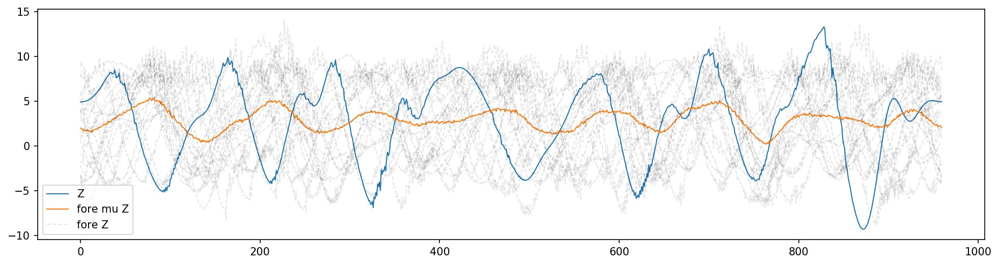

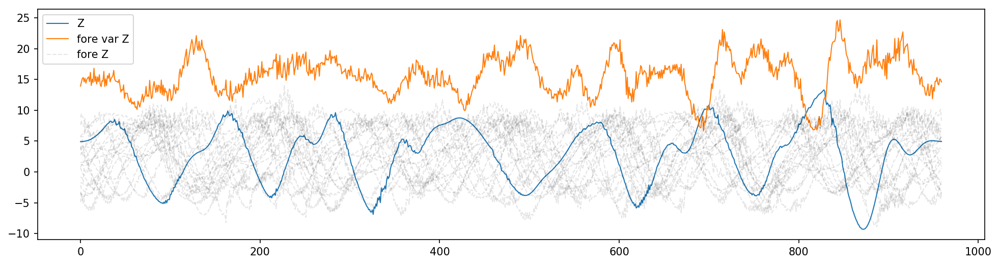

In [548]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'fore var Z', 'fore Z'])

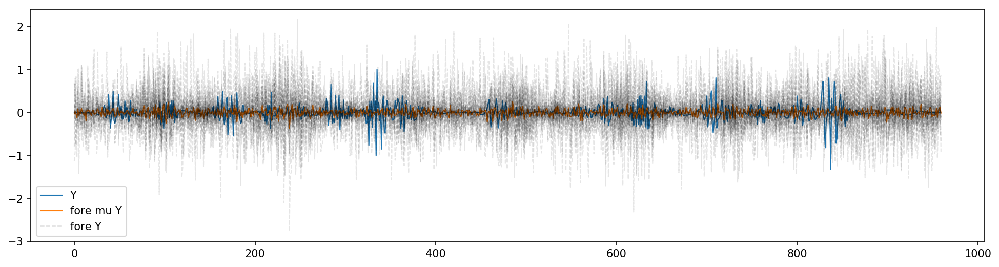

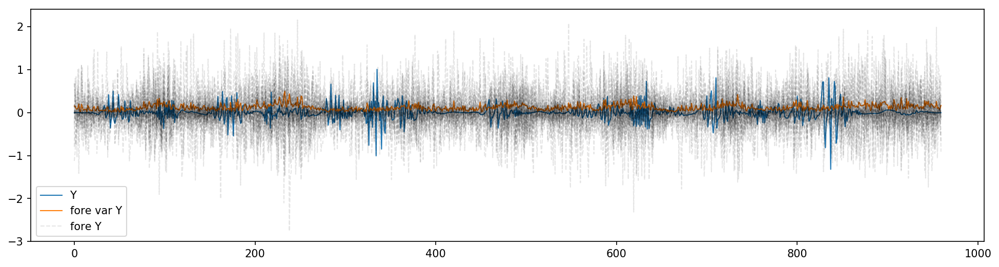

In [549]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_ts.isel(time=0), linewidth=1)
plt.plot(np.mean(Y0_ens, axis=-1), linewidth=1)
plt.plot(Y0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Y0_ens, axis=-1), linewidth=1)
plt.plot(Y0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Y', 'fore var Y', 'fore Y'])

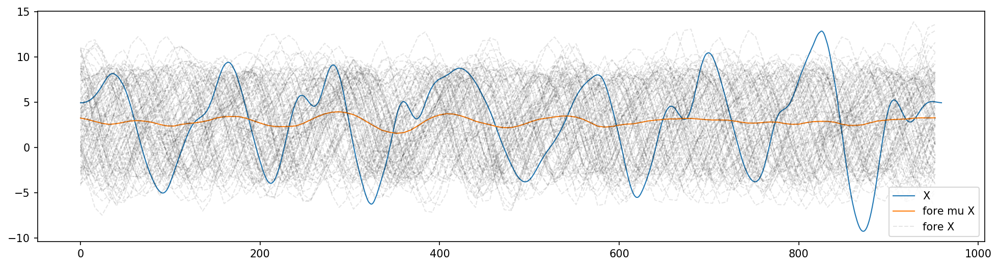

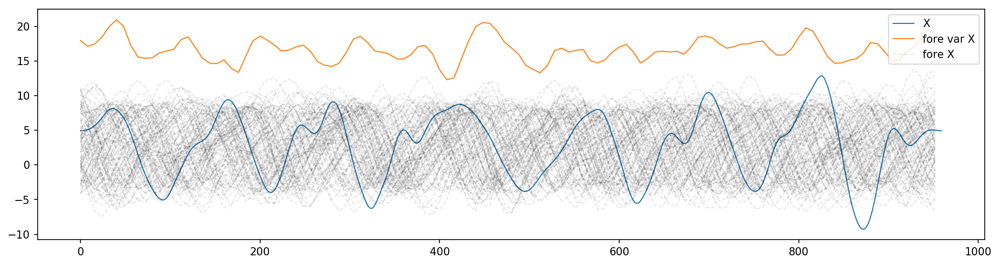

In [550]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(X_ts.isel(time=0), linewidth=1)
plt.plot(x_coar, np.mean(X0_ens, axis=-1), linewidth=1)
plt.plot(x_coar, X0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['X', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(X_ts.isel(time=0), linewidth=1)
plt.plot(x_coar, np.var(X0_ens, axis=-1), linewidth=1)
plt.plot(x_coar, X0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['X', 'fore var X', 'fore X'])

In [551]:
co_spacing = 32
den_patches = 15
# patch_size = 15
patch_size = 25

Zc_obs_loc = np.arange(N_Z)[::co_spacing]
# Zc_obs_loc = np.array([])

dense_patch = np.arange(-patch_size//2, patch_size//2 + 1)
dense_patch_loc = np.random.choice(N_Z, size=den_patches, replace=False)
Zd_obs_loc = dense_patch_loc[:, None] + dense_patch[None, :]
Zd_obs_loc = Zd_obs_loc.ravel() % N_Z
Zd_obs_loc = np.unique(Zd_obs_loc)
Zd_obs_loc.sort()

Z_obs_loc = np.concatenate([Zc_obs_loc, Zd_obs_loc])

N_co = Zc_obs_loc.size
N_do = Zd_obs_loc.size
print('Coarse obs size: ', N_co)
print('Dense obs size: ', N_do)

Coarse obs size:  30
Dense obs size:  311


R and H for Z

In [552]:
R_Zc_sd = 1
R_Zd_sd = 0.1
R_Z = np.diag(np.concatenate([R_Zc_sd**2 * np.ones(N_co), R_Zd_sd**2 * np.ones(N_do)]))
# R_Z = np.diag(R_Zd_sd**2 * np.ones(N_do))

H_coar = np.eye(N_Z)[Zc_obs_loc]
H_dense = np.eye(N_Z)[Zd_obs_loc]
H_Z = np.concatenate([H_coar, H_dense], axis=0)
# H_Z = H_dense

R and H for X

In [553]:
R_Xc_sd = 1
R_Xc = (R_Xc_sd**2) * np.eye(N_Xc)
H_Xc = np.eye(N_Xc)

H_f2c = np.eye(N_Z)[::coarse]
X_obs_loc = np.arange(N_Z)[::coarse]

In [554]:
Z_obs_ts = H_Z @ Z_ts.sel(time=t_obs)
X_obs_ts = H_f2c @ X_ts.sel(time=t_obs)

In [555]:
Z_obs_ts = Z_obs_ts + np.random.multivariate_normal(np.zeros(N_co + N_do), R_Z, t_obs.size).T
X_obs_ts = X_obs_ts + np.random.multivariate_normal(np.zeros(N_Xc), R_Xc, t_obs.size).T

Z_obs_ts = xr.DataArray(Z_obs_ts,
                        dims=('loc', 'time'),
                        coords={'loc': Z_obs_loc,
                                'time': t_obs})
X_obs_ts = xr.DataArray(X_obs_ts,
                        dims=('loc', 'time'),
                        coords={'loc': X_obs_loc,
                                'time': t_obs})

In [556]:
%matplotlib inline

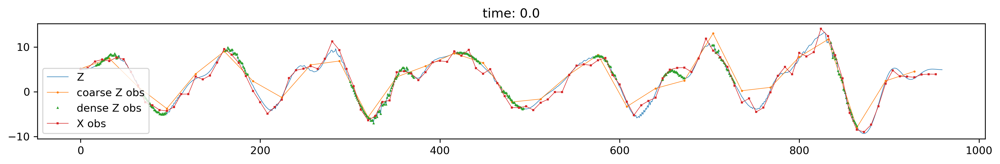

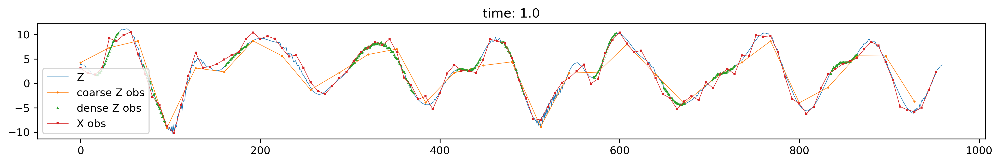

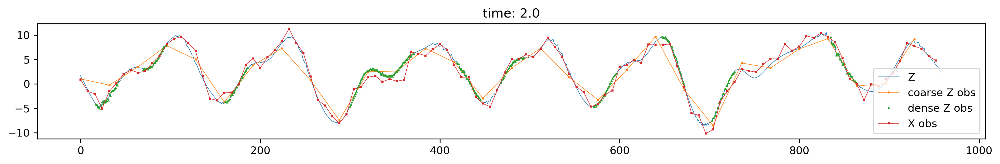

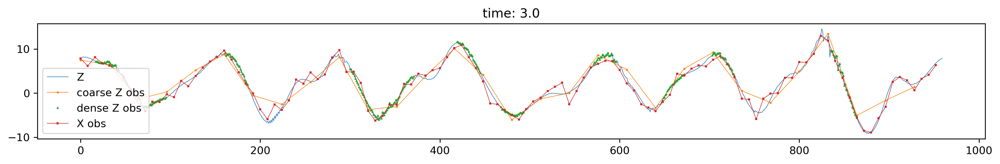

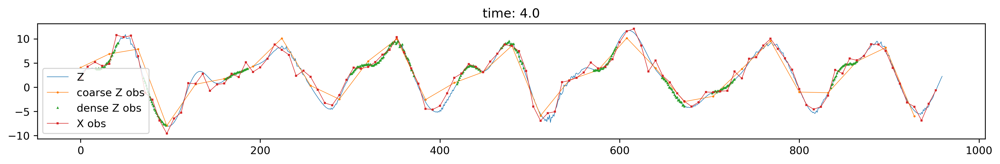

...

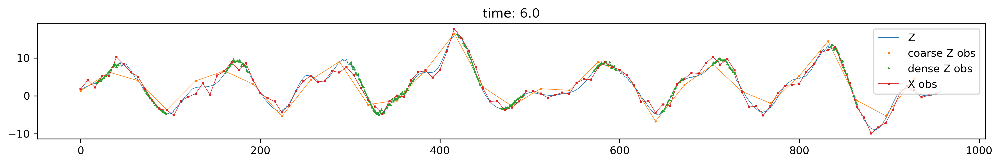

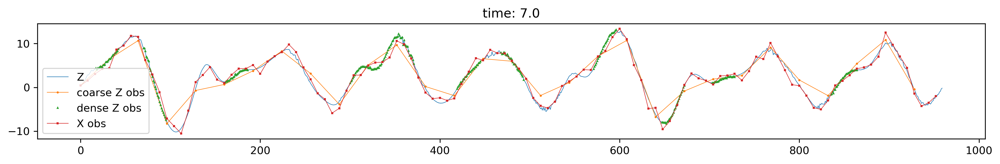

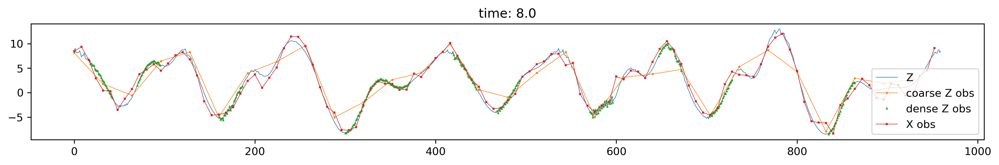

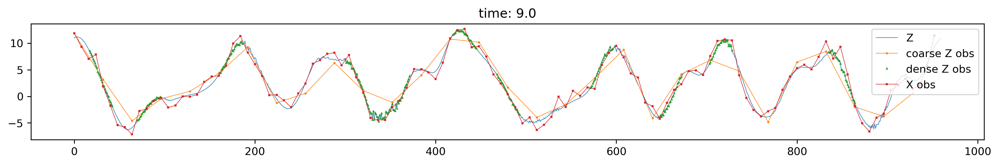

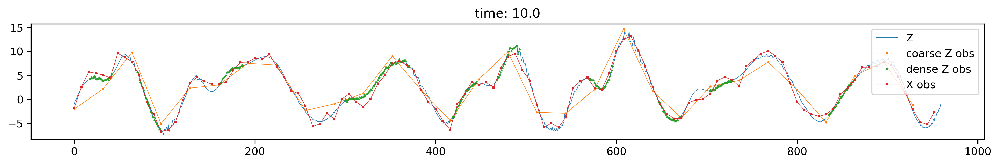

In [557]:
for at in Z_obs_ts.time.values:
    
    figsize = plt.figaspect(1/8)
    plt.figure(dpi=300, figsize=figsize)
    plt.plot(Z_ts.sel(time=at), linewidth=0.5)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=at).values[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=at).values[N_co:], '^', markersize=.75)
    plt.plot(X_obs_loc, X_obs_ts.sel(time=at), '-s', markersize=1, linewidth=0.5)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'X obs'])
    plt.title(f'time: {at}')

# Assim one observation

In [558]:
atitle = 'standard loc'

In [559]:
importlib.reload(assimilate)
importlib.reload(utilities)

rho0_Zf = 5
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
# imshow(rho_Zf, 'rho Zf',
#        vmin=0, vmax=1)
# imshow(rho_Zf[:20, :20], 'rho Zf zoom',
#        vmin=0, vmax=1)

rho0_Zc = 100
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
# imshow(rho_Zc, 'rho Zc',
#        vmin=0, vmax=1)
# rho_Zc = None



# assim_type = 'SVD_loc'
assim_type = 'standard loc'
return_details = True
X_ens_a, Z_ens_a, details = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs_ts.isel(time=0).values, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs_ts.isel(time=0).values, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    rho_Zf=rho_Zf,
    rho_Zc=rho_Zc, rho=rho_Zc,
    assim_type=assim_type, return_details=return_details)

In [560]:
%matplotlib inline

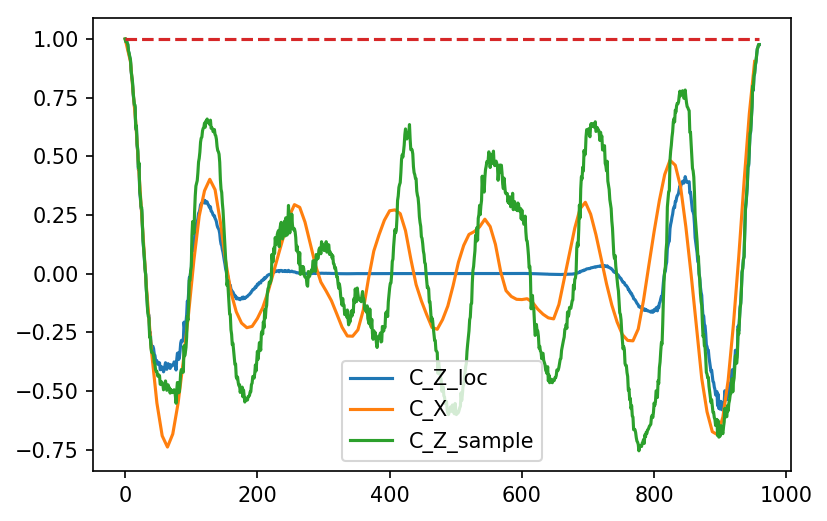

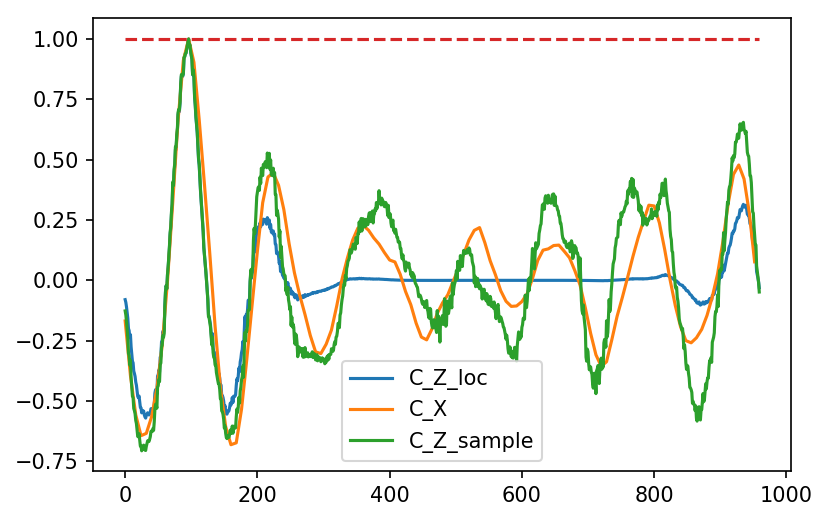

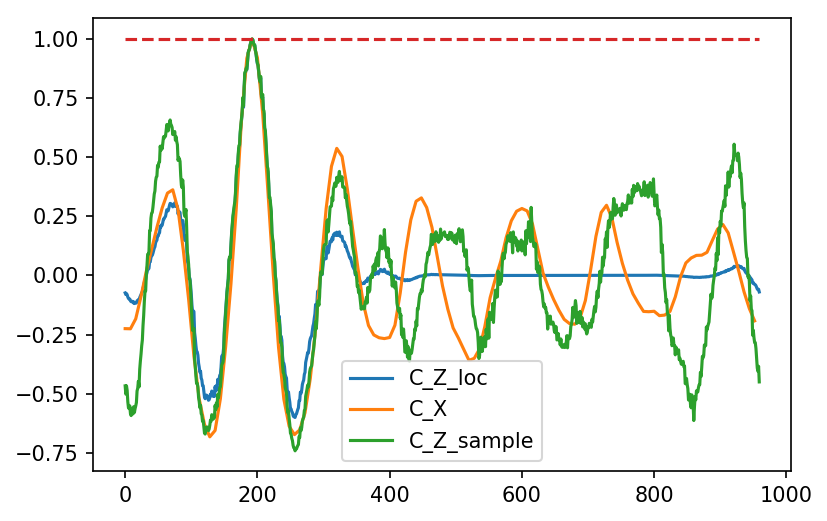

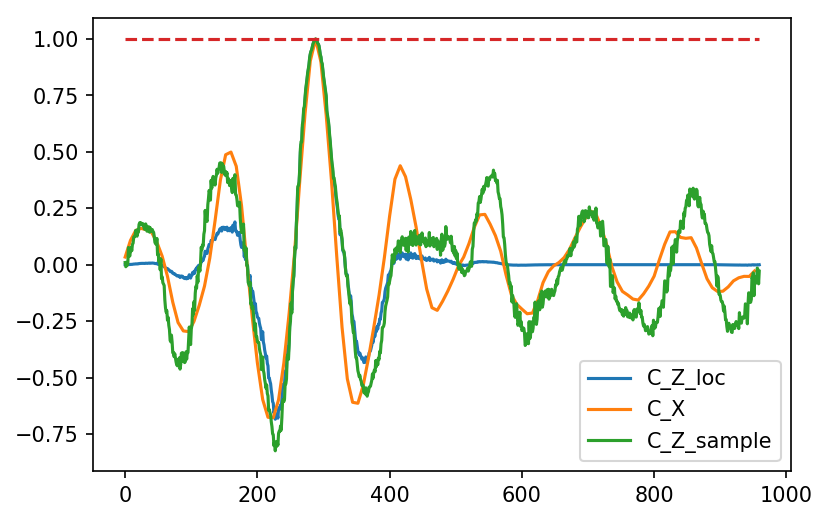

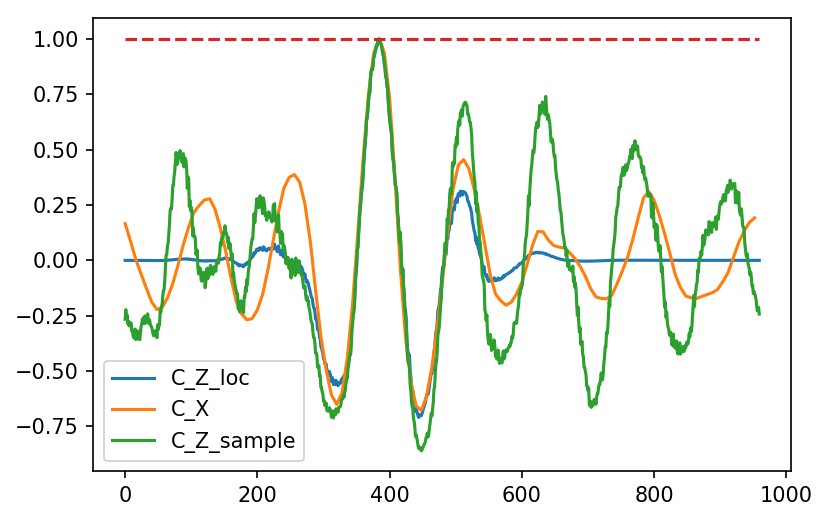

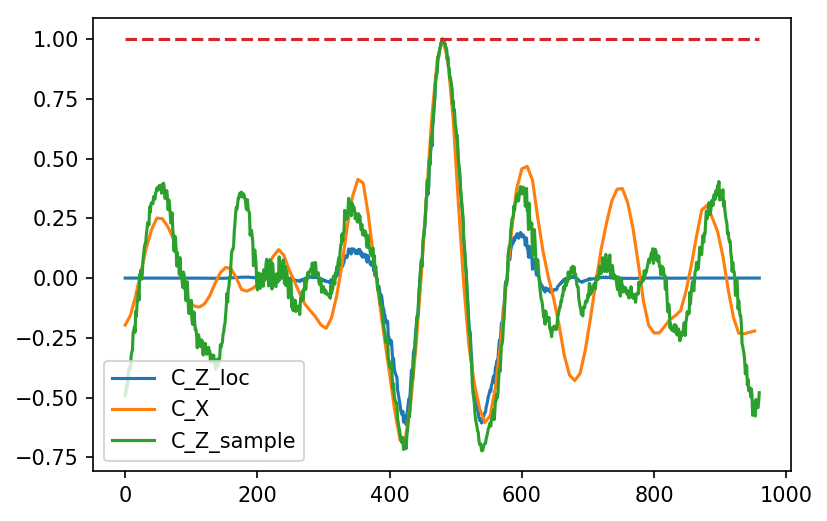

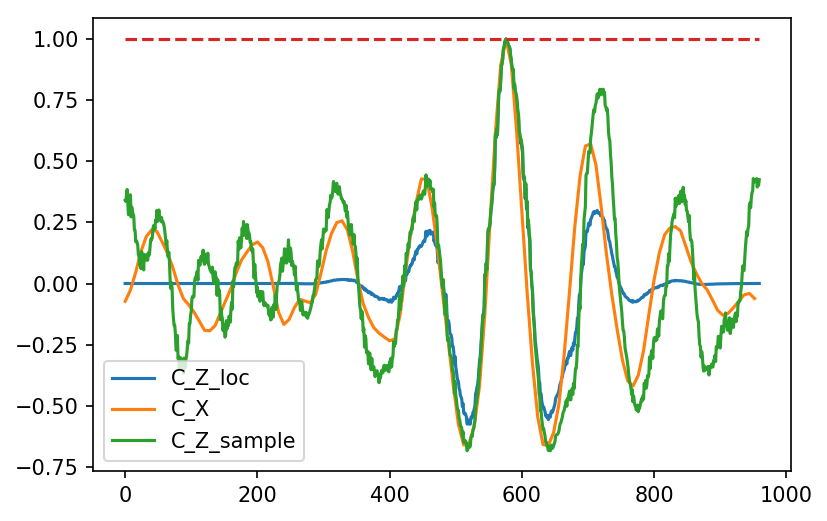

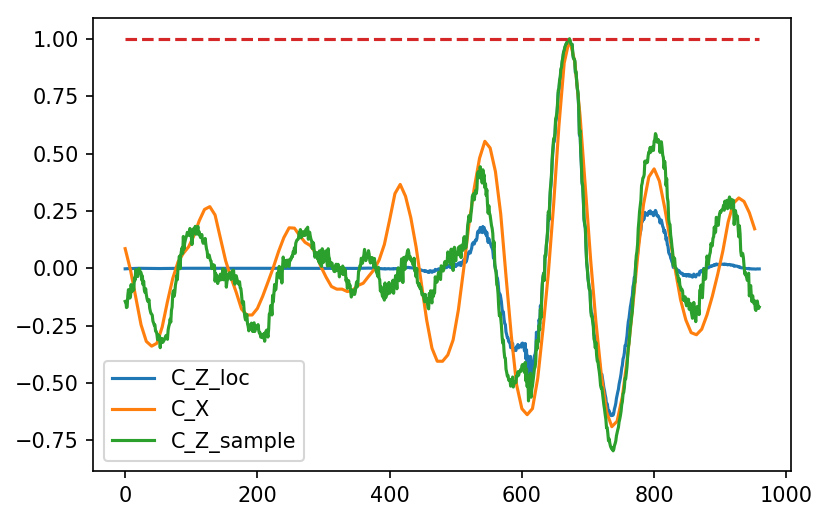

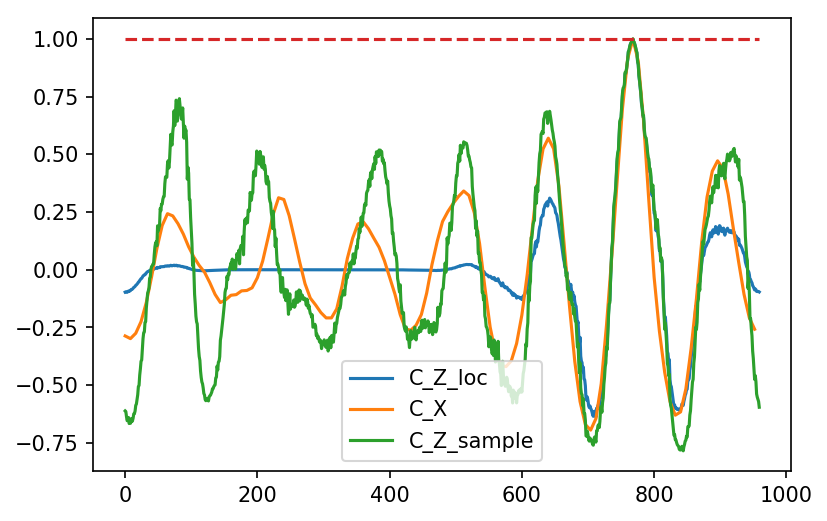

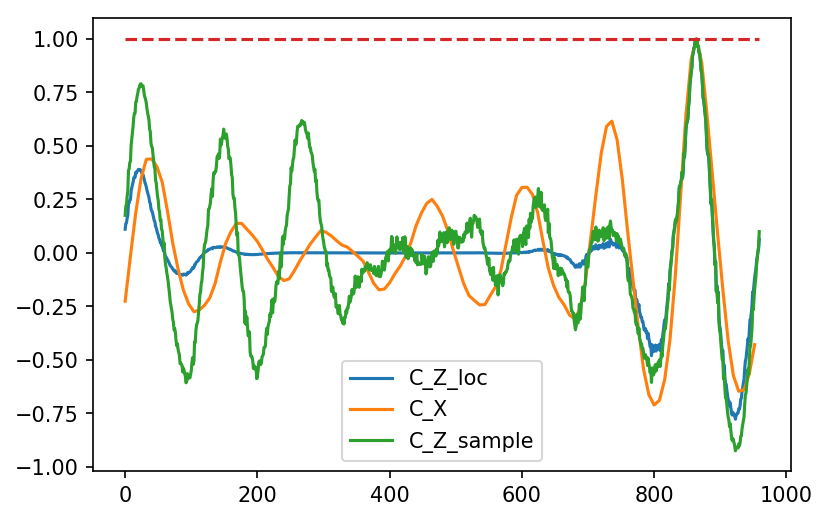

In [561]:
C_X = np.corrcoef(X0_ens)
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['C_Z_loc'][ii])
    plt.plot(x_coar, C_X[iic])
    plt.plot(details['C_Z_sample'][ii])
    plt.plot(np.ones(N_Z), '--')
    plt.legend(['C_Z_loc', 'C_X', 'C_Z_sample'])

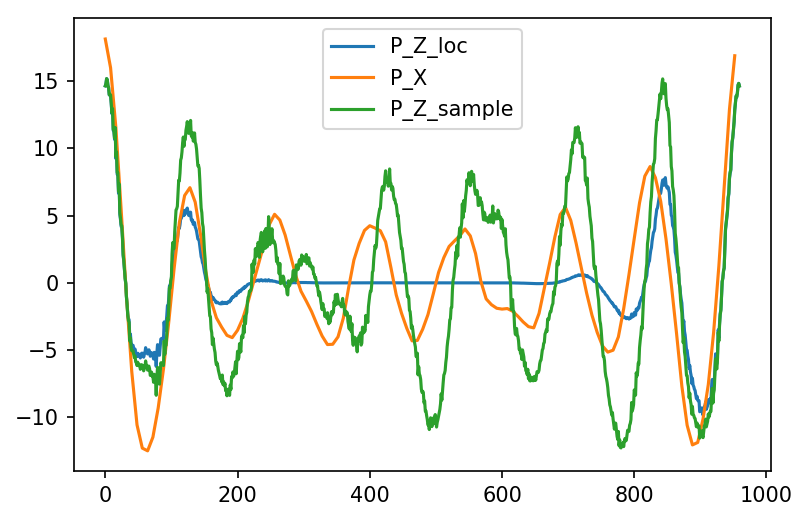

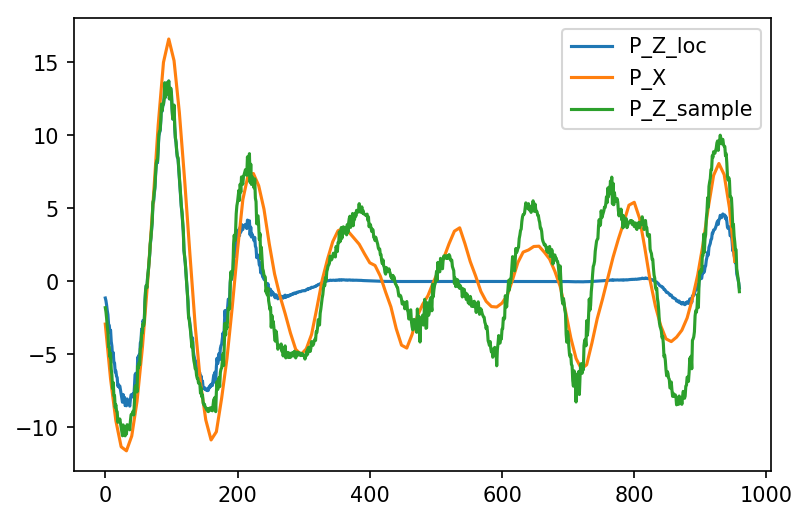

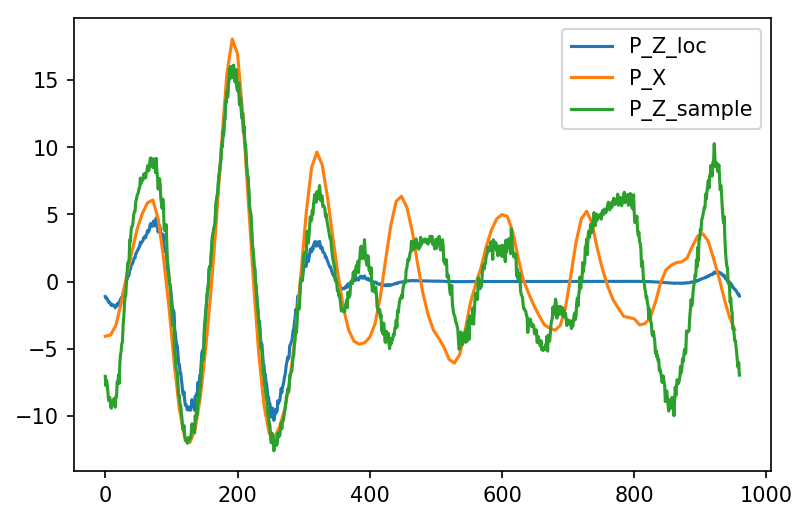

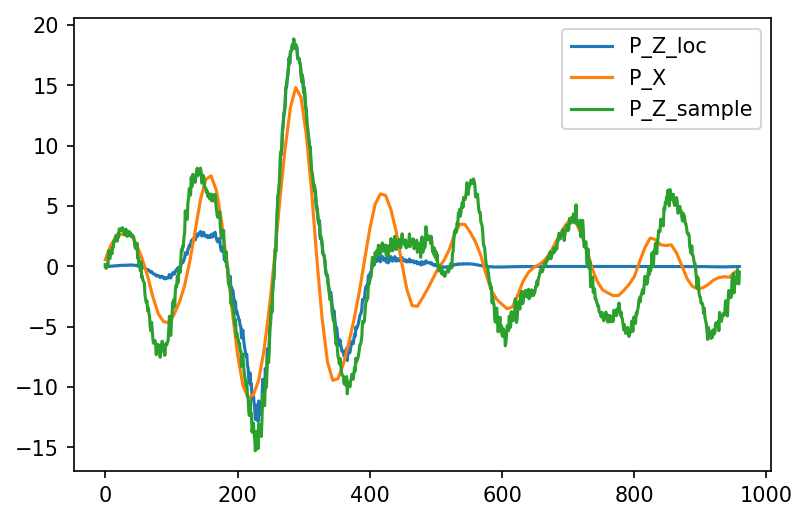

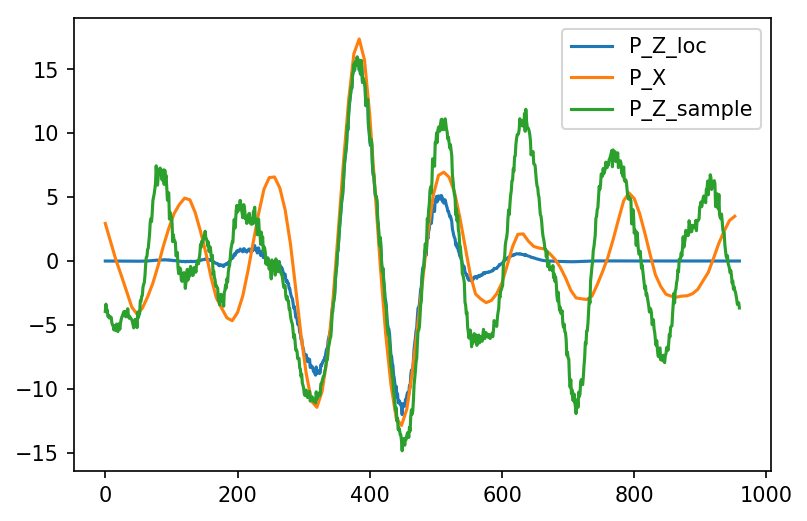

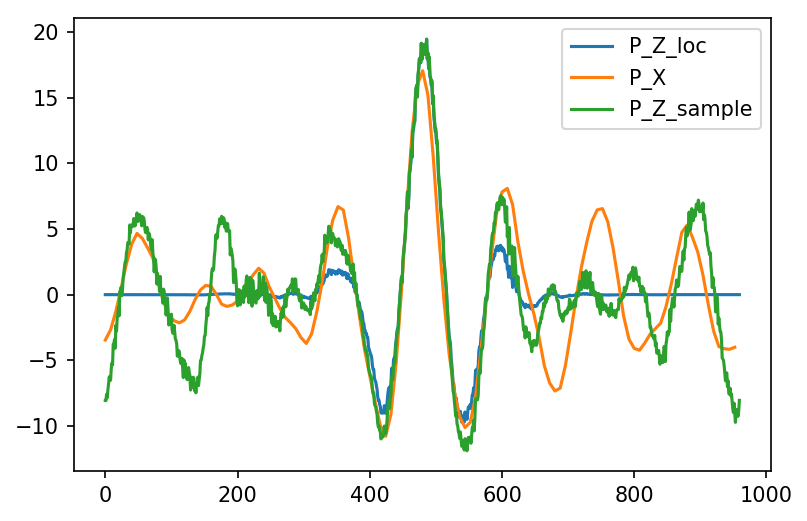

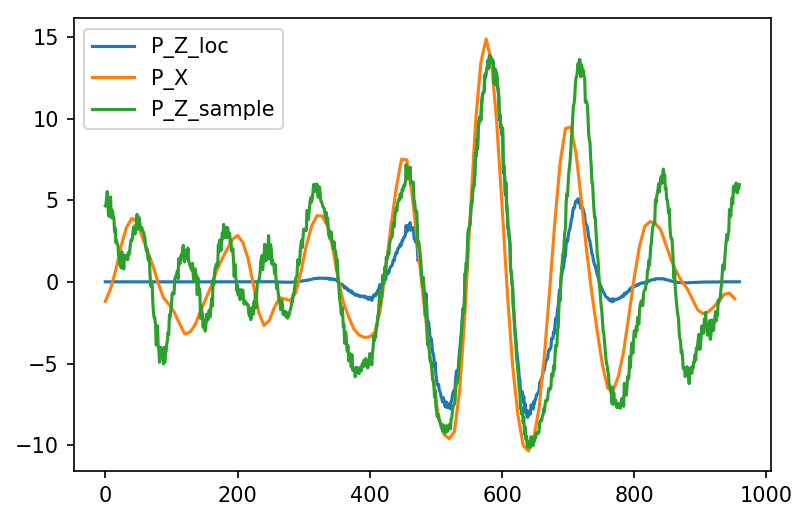

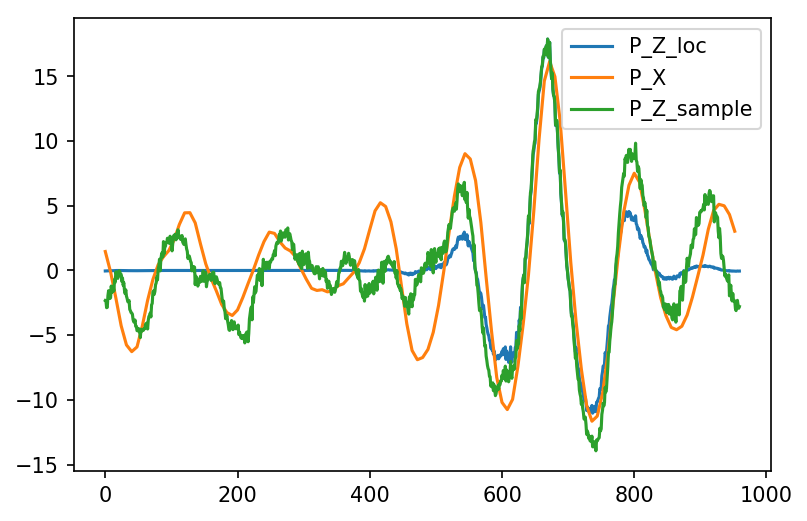

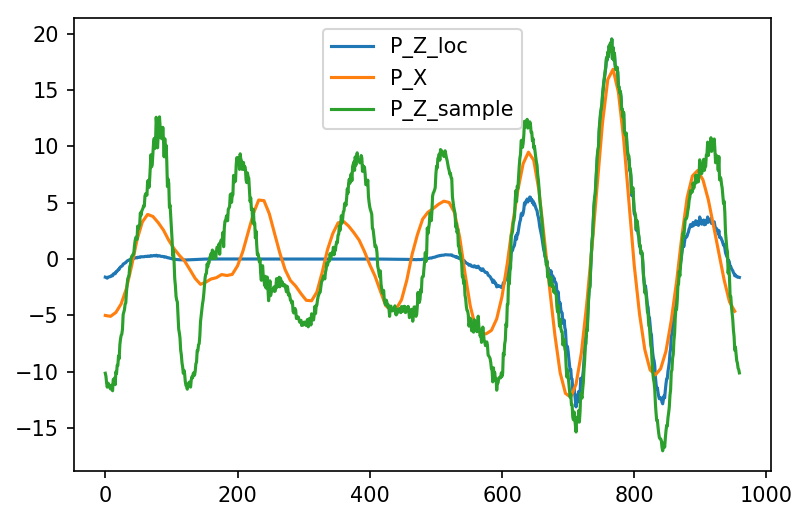

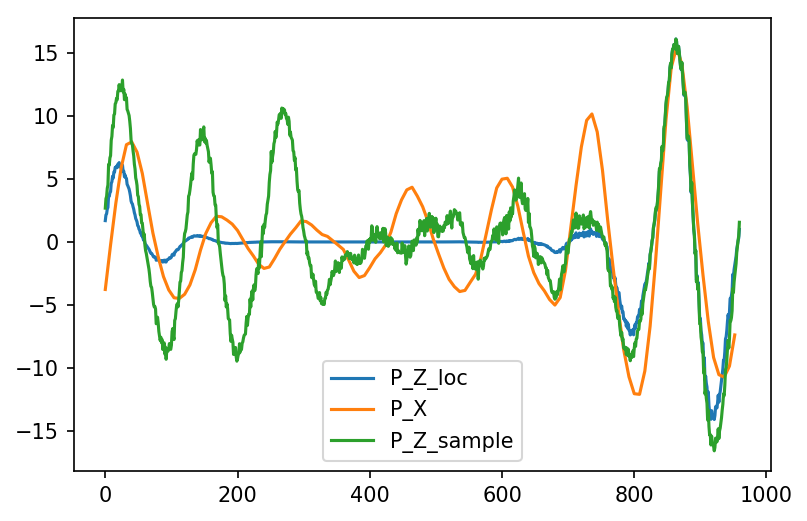

In [562]:
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['P_Z_loc'][ii])
    plt.plot(x_coar, details['P_X_sample'][iic])
    plt.plot(details['P_Z_sample'][ii])
#     plt.plot(np.ones(N_Z), '--')
    plt.legend(['P_Z_loc', 'P_X', 'P_Z_sample'])

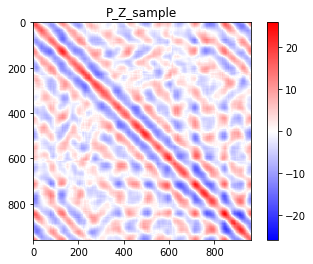

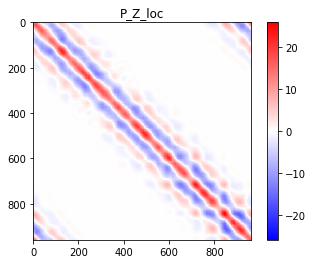

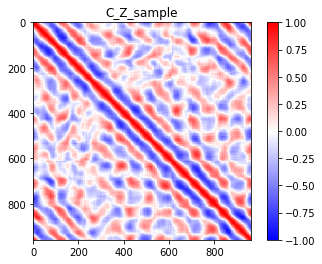

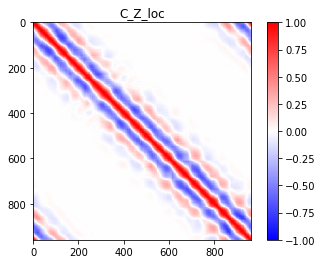

In [563]:
P_Z_sample = details['P_Z_sample']
P_Z_loc = details['P_Z_loc']

vmax = np.max([
    np.abs(P_Z_sample).max(),
    np.abs(P_Z_loc).max()])
imshow(P_Z_sample, title='P_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(P_Z_loc, title='P_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

C_Z_sample = details['C_Z_sample']
C_Z_loc = details['C_Z_loc']

vmax = np.max([
    np.abs(C_Z_sample).max(),
    np.abs(C_Z_loc).max()])
imshow(C_Z_sample, title='C_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(C_Z_loc, title='C_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

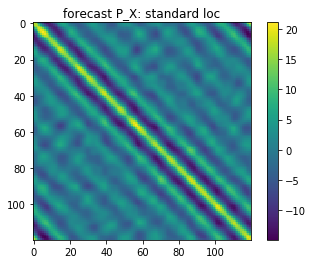

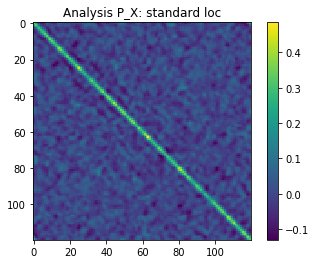

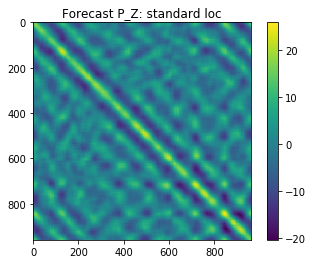

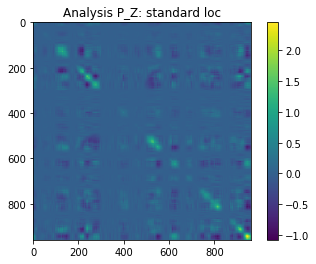

In [564]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

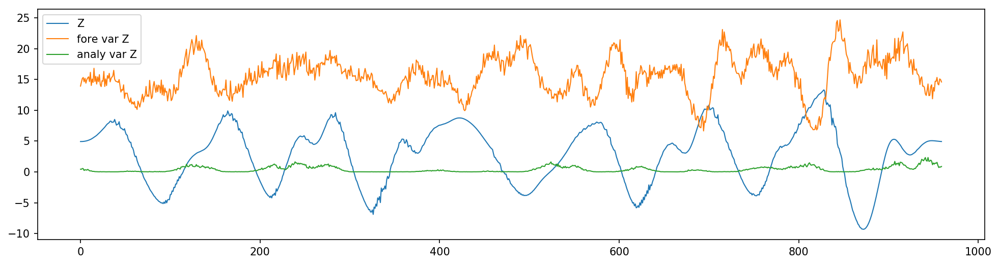

In [565]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.legend(['Z', 'fore var Z', 'analy var Z'])

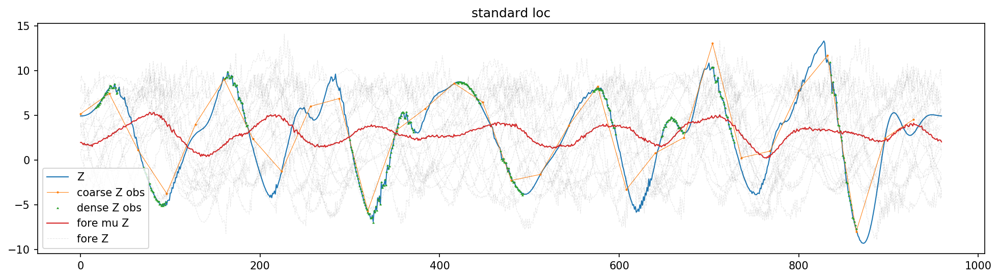

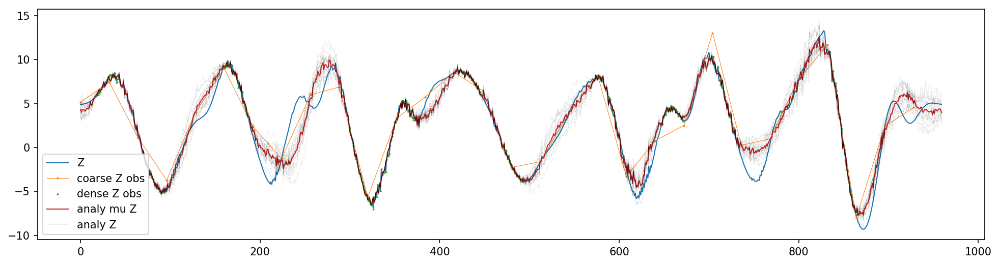

In [566]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.isel(time=0).values[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.isel(time=0).values[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.isel(time=0).values[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.isel(time=0).values[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

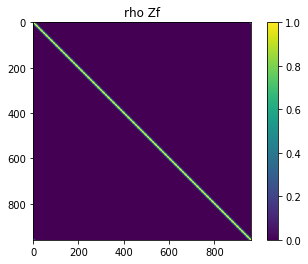

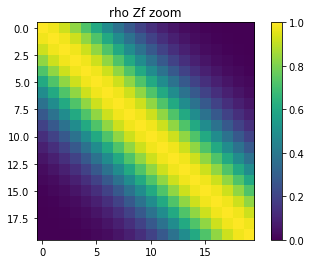

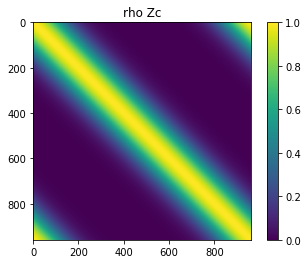

In [567]:
importlib.reload(assimilate)
importlib.reload(utilities)

rho0_Zf = 5
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
imshow(rho_Zf, 'rho Zf',
       vmin=0, vmax=1)
imshow(rho_Zf[:20, :20], 'rho Zf zoom',
       vmin=0, vmax=1)

rho0_Zc = 100
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
imshow(rho_Zc, 'rho Zc',
       vmin=0, vmax=1)
# rho_Zc = None



assim_type = 'SVD_loc'
# assim_type = 'standard loc'
return_details = True
use_sample_var = True
sig_fraction = 1
X_ens_a, Z_ens_a, details = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs_ts.isel(time=0).values, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs_ts.isel(time=0).values, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_Zf=rho_Zf,
    rho_Zc=rho_Zc, rho=rho_Zf,
    sig_fraction=sig_fraction,
    assim_type=assim_type, return_details=return_details,
    use_sample_var=use_sample_var)

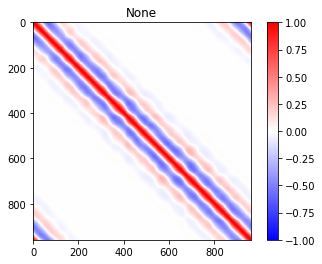

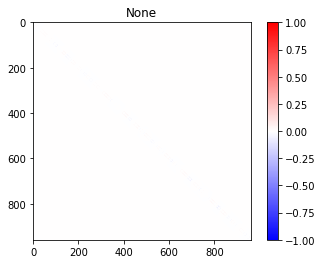

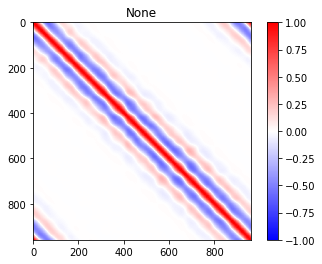

In [568]:
imshow(details['C_Z_ll'], vmax=1, vmin=-1, cmap='bwr')

imshow(details['C_Z_orth'], vmax=1, vmin=-1, cmap='bwr')
imshow(details['C_Z_loc'], vmax=1, vmin=-1, cmap='bwr')

In [569]:
%matplotlib inline

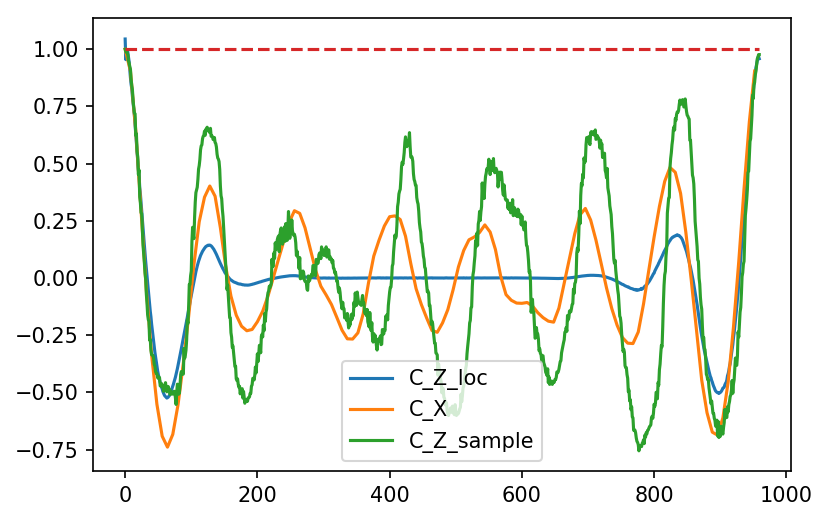

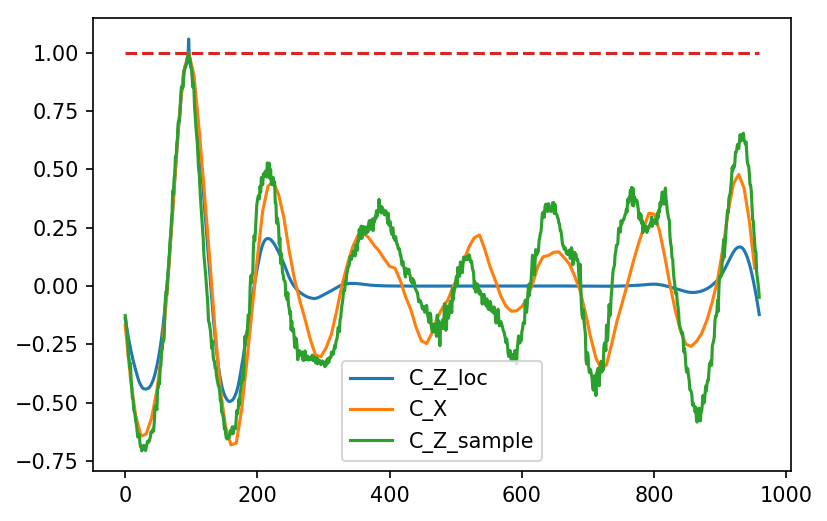

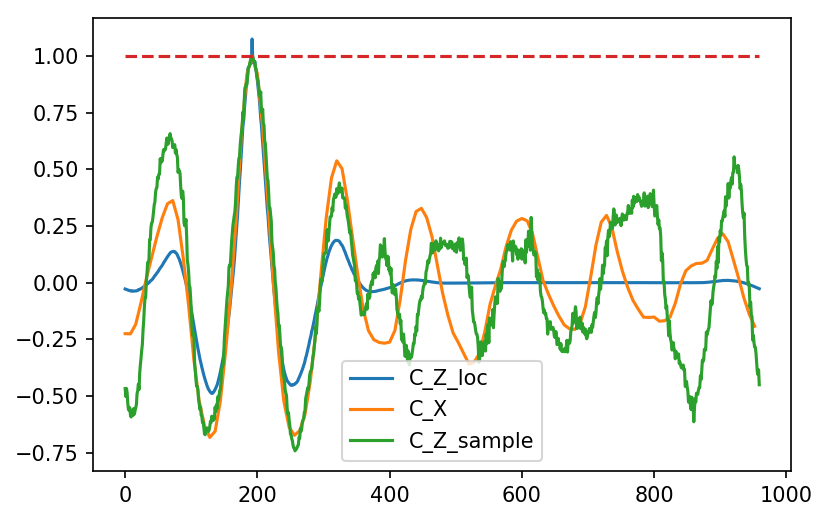

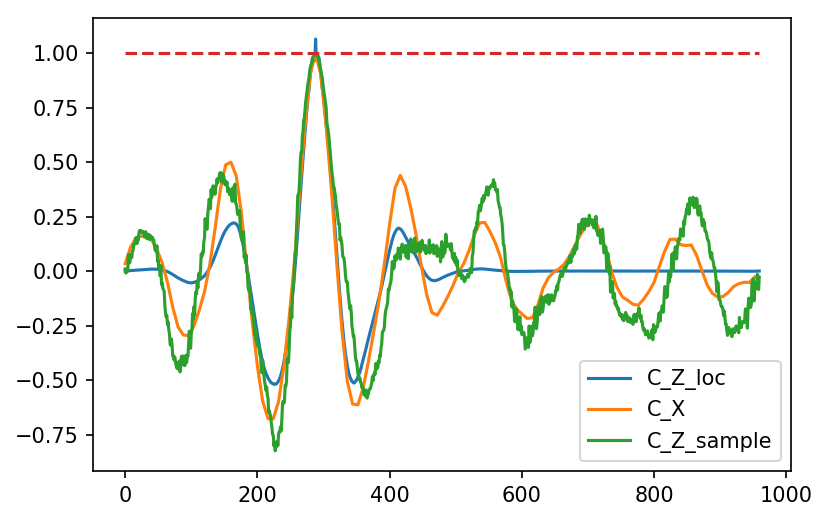

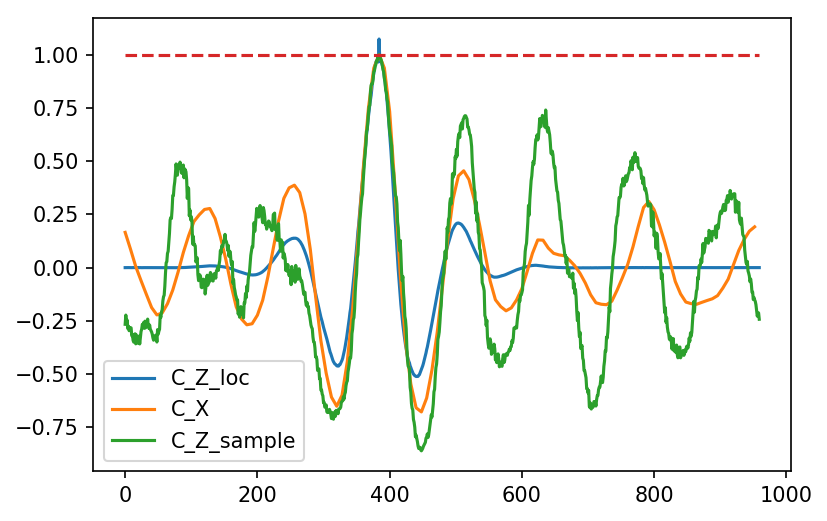

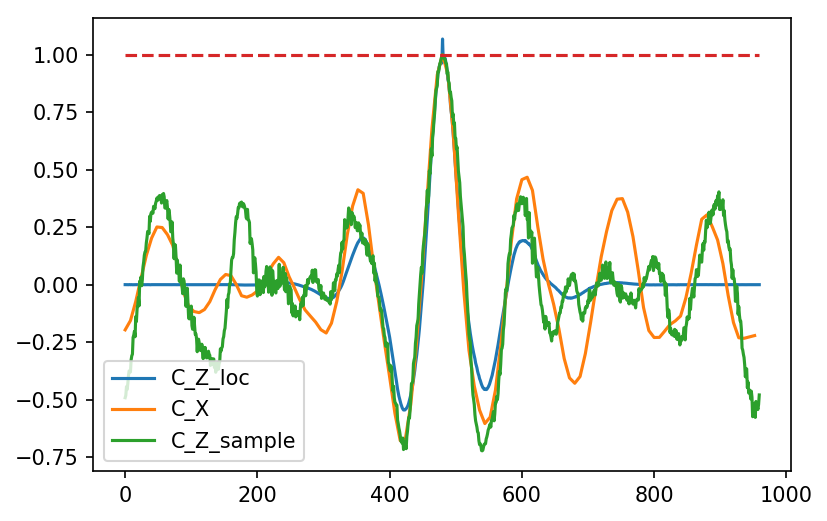

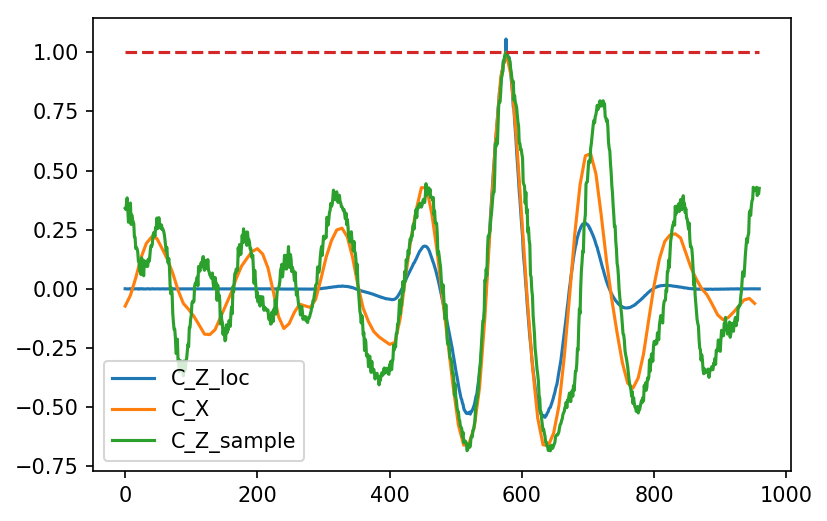

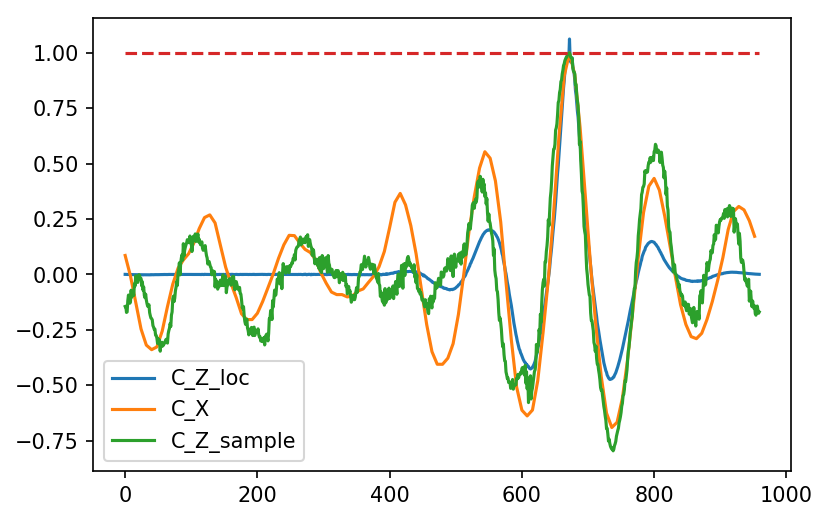

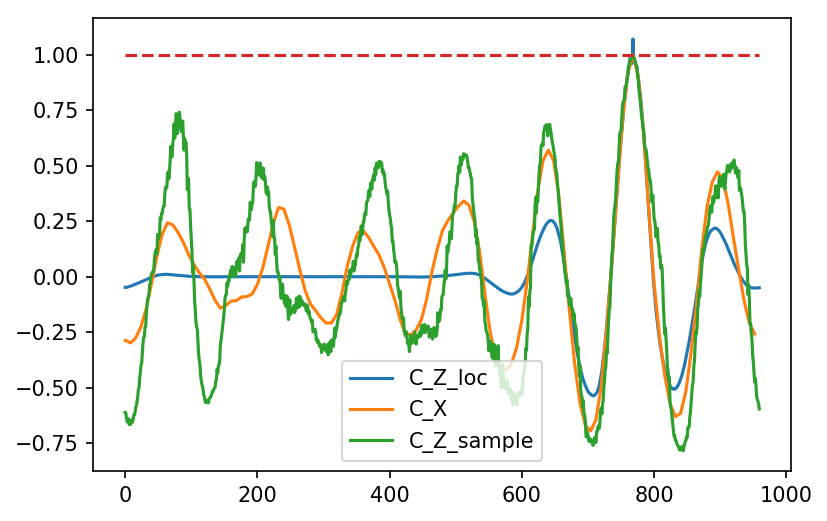

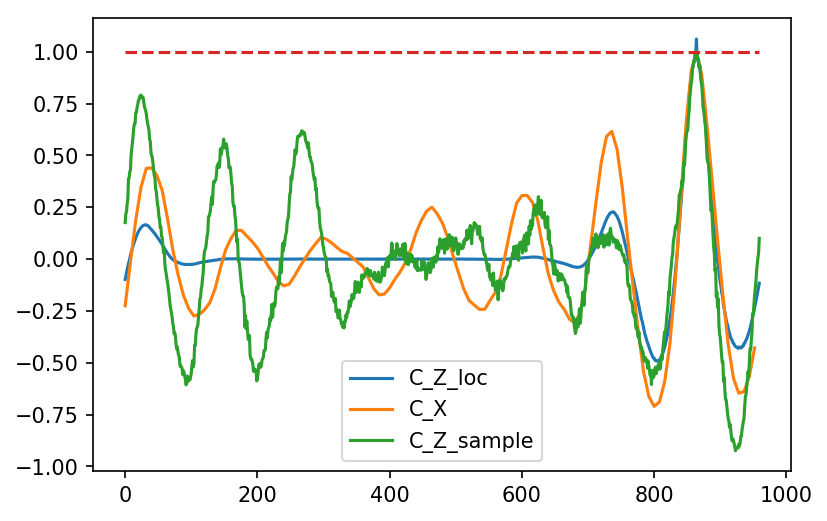

In [570]:
C_X = np.corrcoef(X0_ens)
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['C_Z_loc'][ii])
    plt.plot(x_coar, C_X[iic])
    plt.plot(details['C_Z_sample'][ii])
    plt.plot(np.ones(N_Z), '--')
    plt.legend(['C_Z_loc', 'C_X', 'C_Z_sample'])

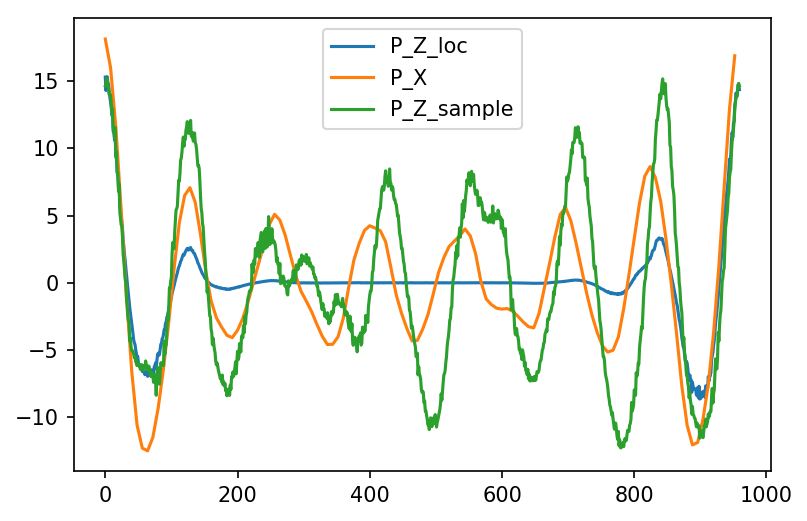

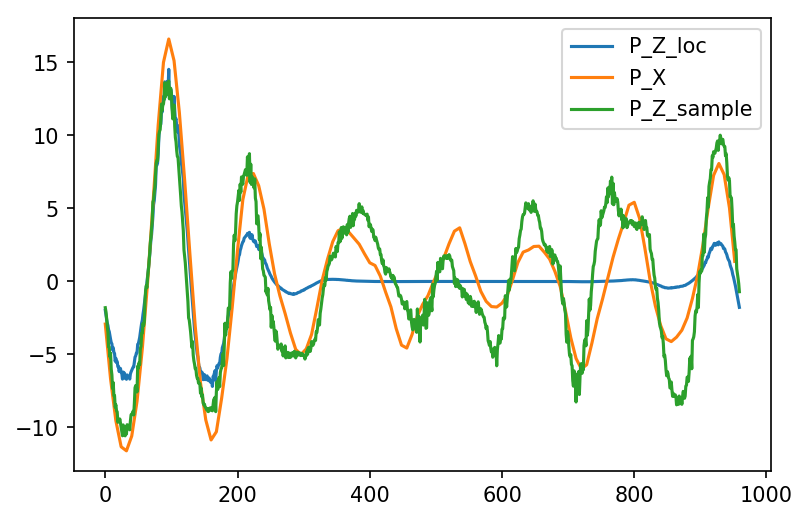

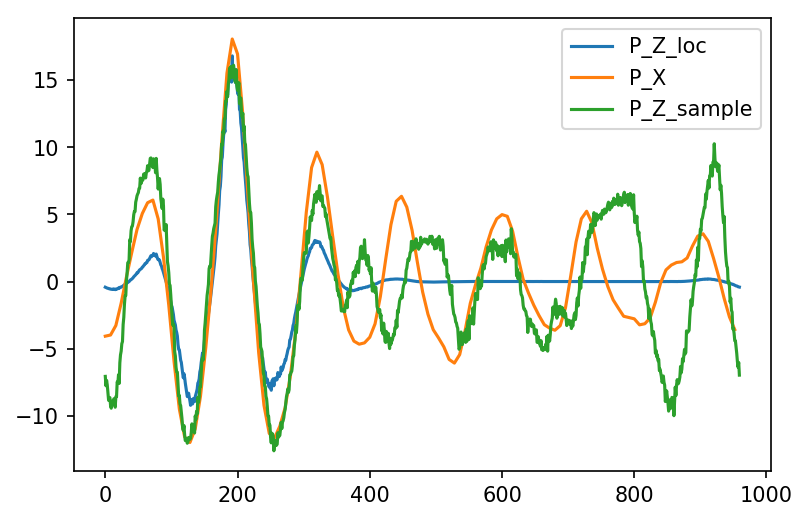

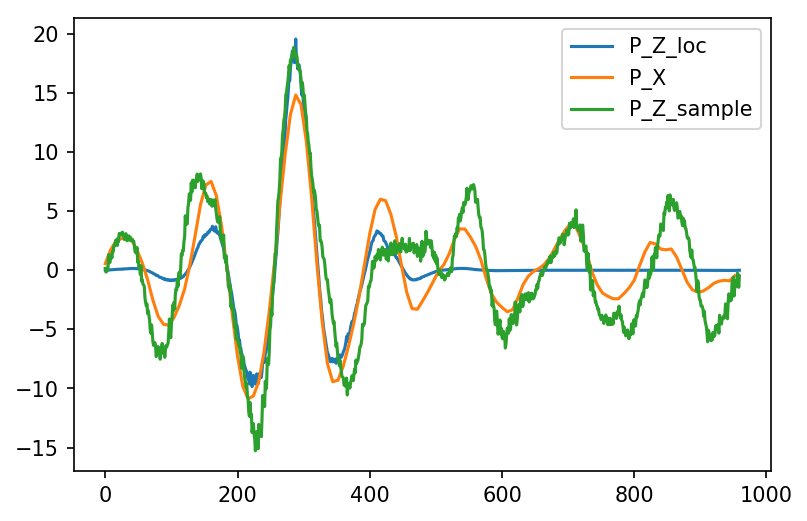

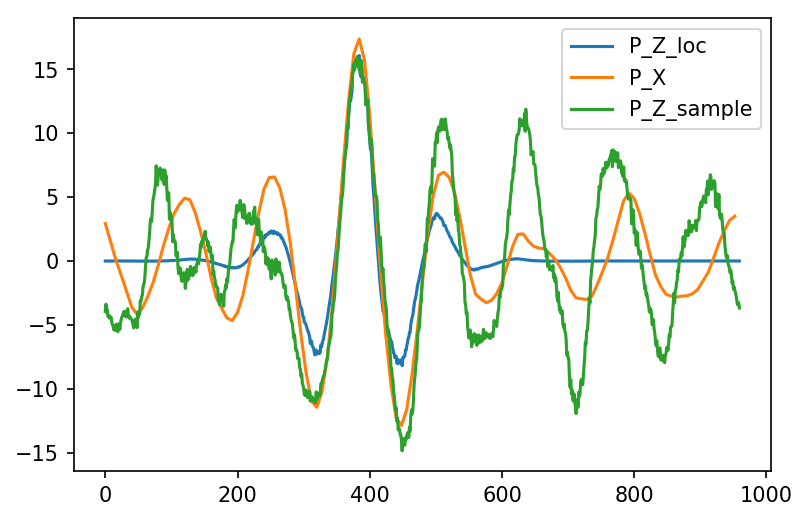

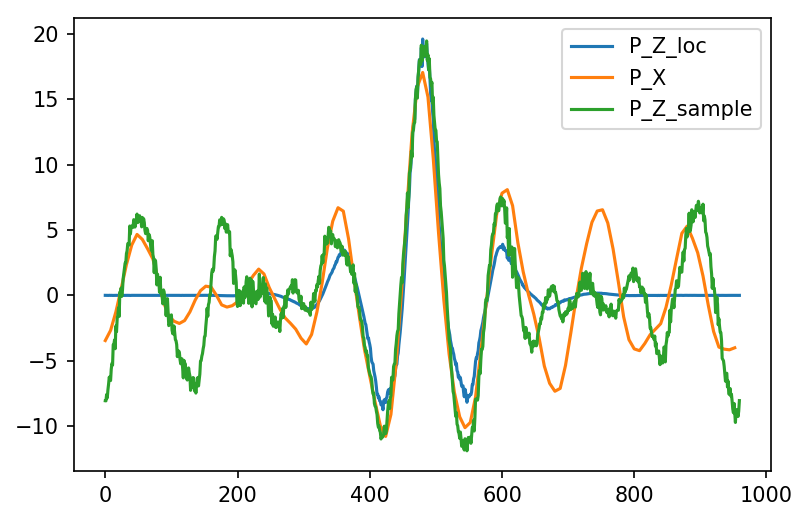

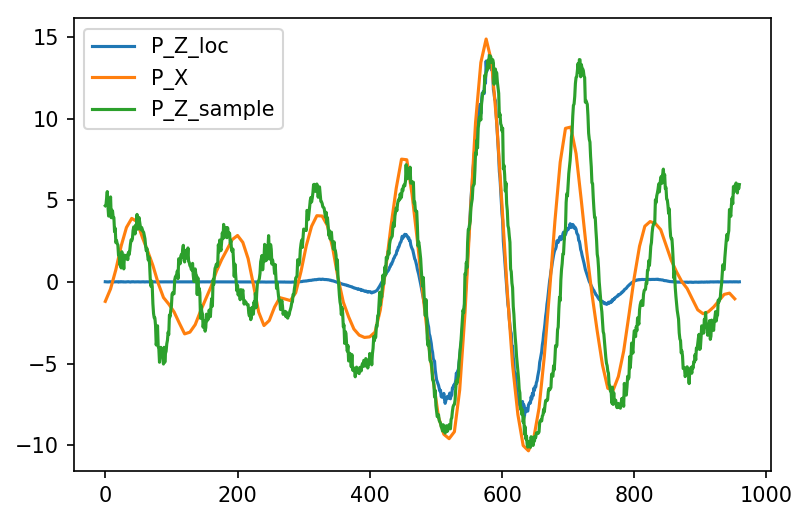

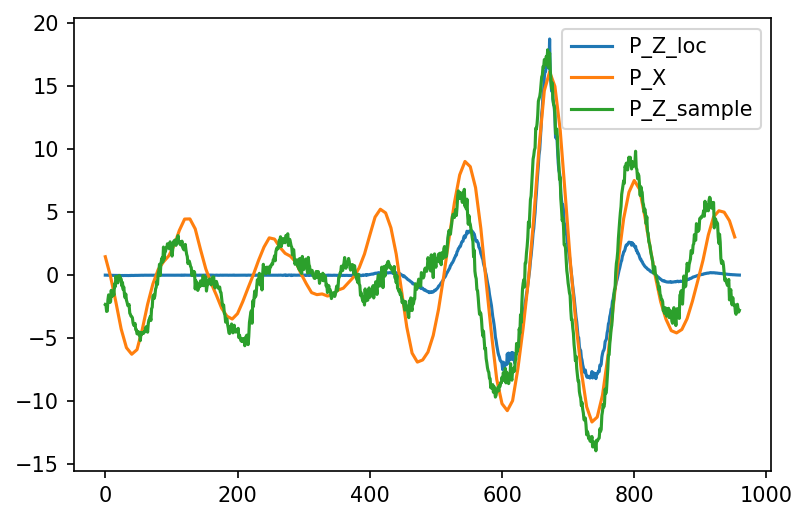

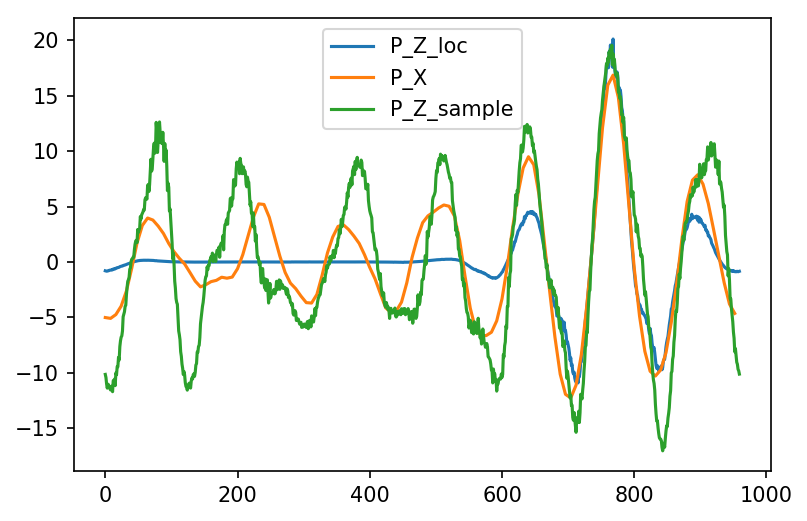

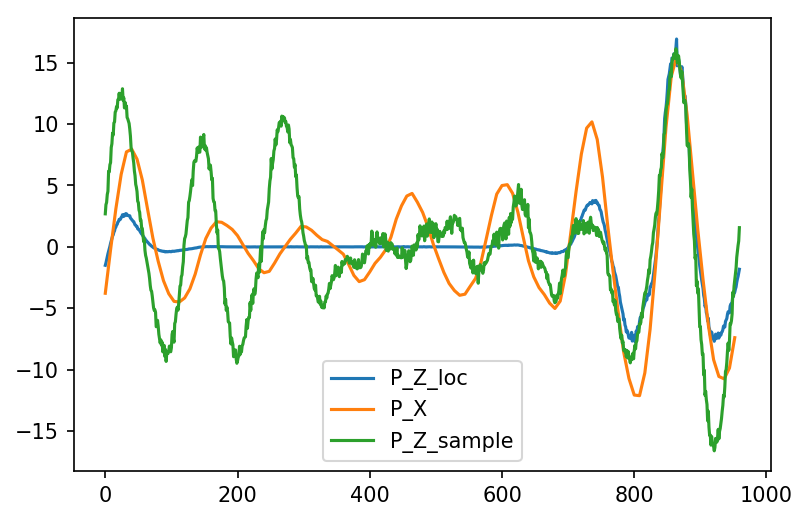

In [571]:
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['P_Z_loc'][ii])
    plt.plot(x_coar, details['P_X_sample'][iic])
    plt.plot(details['P_Z_sample'][ii])
#     plt.plot(np.ones(N_Z), '--')
    plt.legend(['P_Z_loc', 'P_X', 'P_Z_sample'])

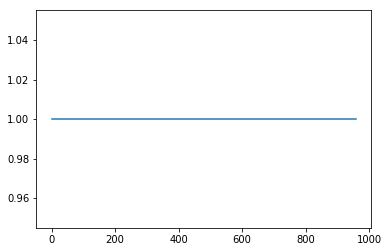

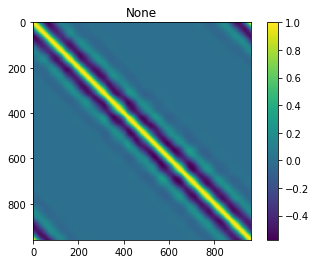

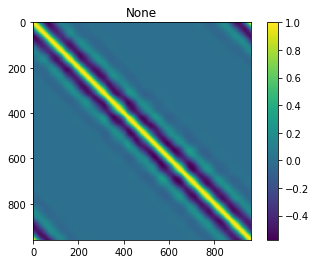

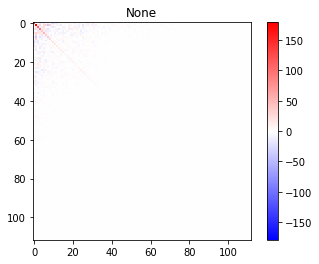

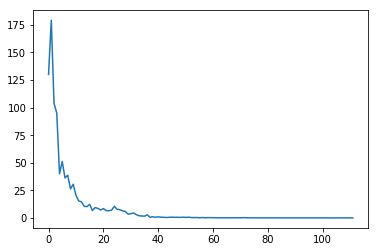

In [572]:
C_Z_sample = details['C_Z_sample']
C_Z_ll = details['C_Z_ll']
VT_X_interp = details['VT_X_interp']

plt.figure()
plt.plot(np.diag(C_Z_ll))

imshow(C_Z_ll)

D_is = np.diag(1/np.sqrt(np.diag(C_Z_ll)))
CC_Z_ll = D_is @ C_Z_ll @ D_is
imshow(CC_Z_ll)

matrix = VT_X_interp @ C_Z_sample @ VT_X_interp.T
vmax = np.abs(matrix).max()
imshow(matrix, vmax=vmax, vmin=-vmax, cmap='bwr')

new_sigs = np.diag(matrix)
neg_sigs = new_sigs.copy()
neg_sigs[neg_sigs >= 0] = np.nan

plt.figure()
plt.plot(new_sigs)
plt.plot(neg_sigs, 'o', markersize=7)

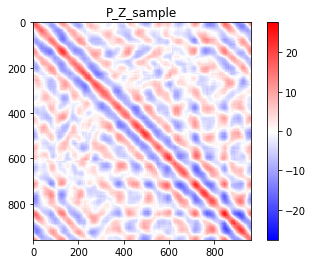

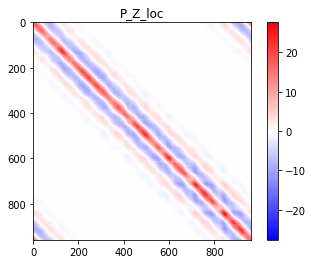

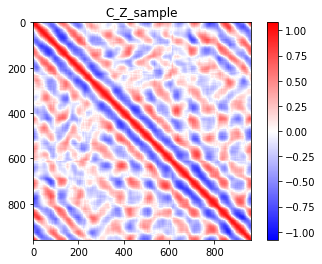

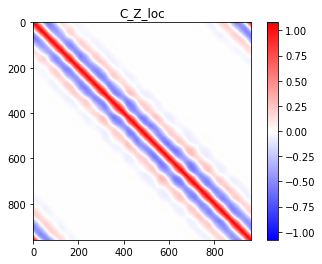

In [573]:
P_Z_sample = details['P_Z_sample']
P_Z_loc = details['P_Z_loc']

vmax = np.max([
    np.abs(P_Z_sample).max(),
    np.abs(P_Z_loc).max()])
imshow(P_Z_sample, title='P_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(P_Z_loc, title='P_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

C_Z_sample = details['C_Z_sample']
C_Z_loc = details['C_Z_loc']

vmax = np.max([
    np.abs(C_Z_sample).max(),
    np.abs(C_Z_loc).max()])
imshow(C_Z_sample, title='C_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(C_Z_loc, title='C_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

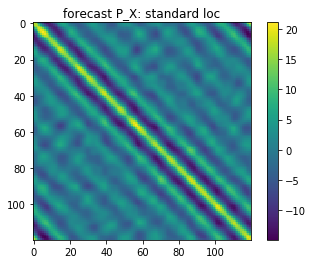

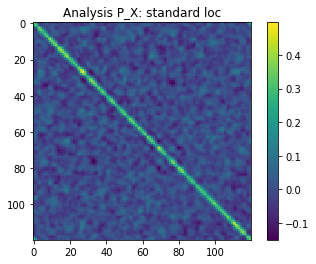

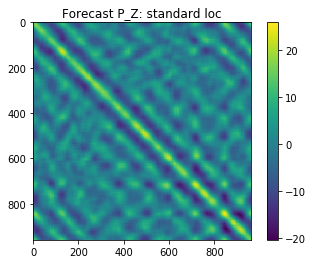

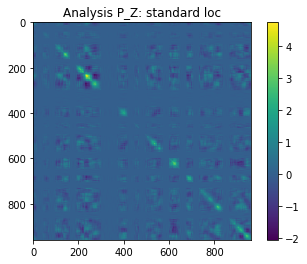

In [574]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

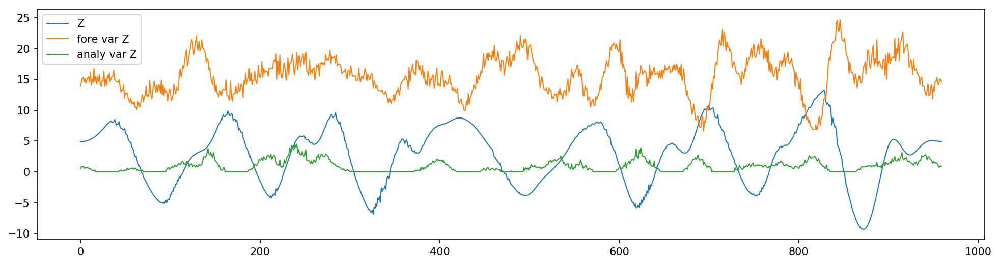

In [575]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.legend(['Z', 'fore var Z', 'analy var Z'])

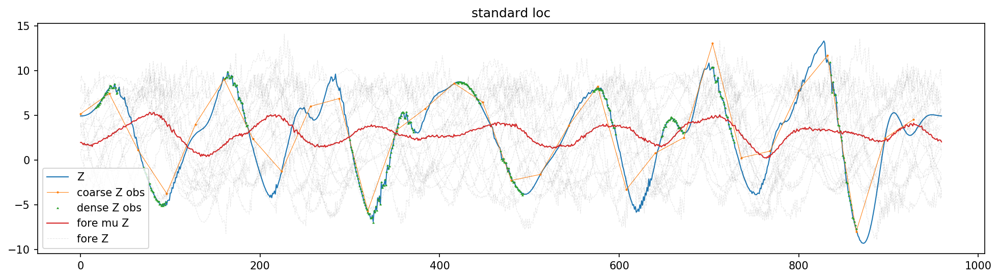

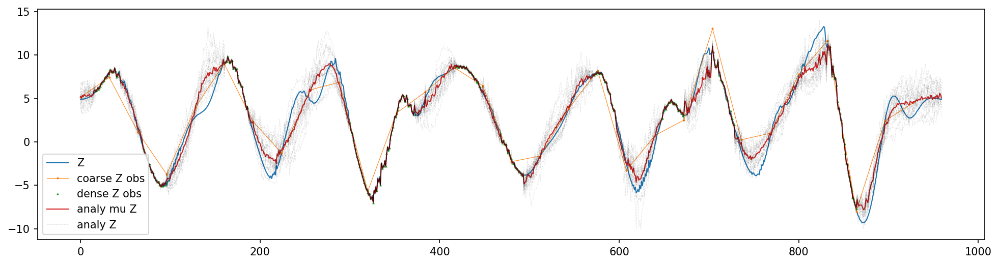

In [576]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.isel(time=0).values[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.isel(time=0).values[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.isel(time=0).values[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.isel(time=0).values[N_co:], '^', markersize=.75)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

# Cycle with SVD localization 

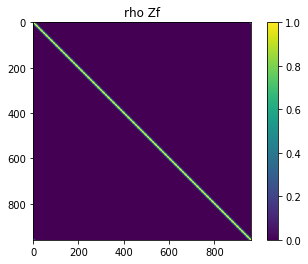

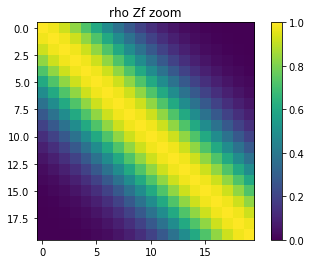

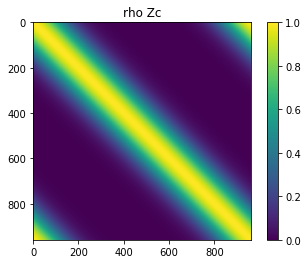

In [600]:
rho0_Zf = 5
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
imshow(rho_Zf, 'rho Zf',
       vmin=0, vmax=1)
imshow(rho_Zf[:20, :20], 'rho Zf zoom',
       vmin=0, vmax=1)

rho0_Zc = 100
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
imshow(rho_Zc, 'rho Zc',
       vmin=0, vmax=1)

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'rho_Zf': rho_Zf,
              'H_sub': H_sub, 'R_sub': R_sub,
              'assim_type': 'SVD_loc'}

In [578]:
importlib.reload(assimilate)
importlib.reload(utilities)

Xa_ens_ts, Za_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
4.0
assimed
pushed Z
pushed X
5.0
assimed
pushed Z
pushed X
6.0
assimed
pushed Z
pushed X
7.0
assimed
pushed Z
pushed X
8.0
assimed
pushed Z
pushed X
9.0
assimed
pushed Z
pushed X
10.0
assimed
pushed Z
pushed X


In [579]:
atitle='SVD loc'

Text(0.5,1,'Z analysis with SVD loc; rmse: 1.127')

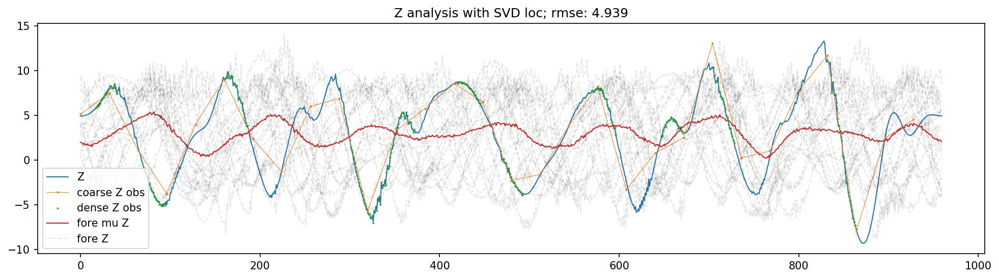

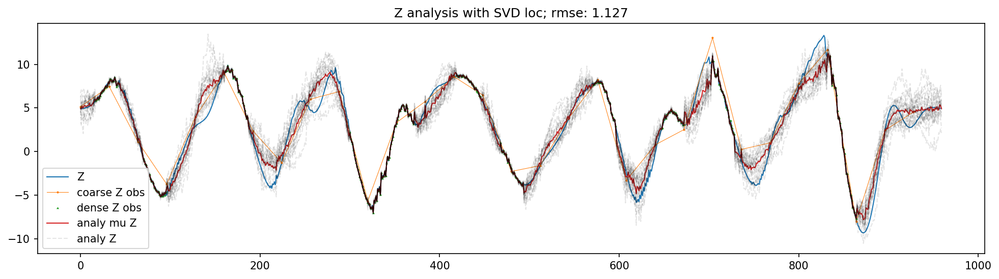

In [580]:
this_time = 0

this_ens = Z0_ens

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')


this_ens = Za_ens_ts[0].sel(time=this_time).values

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

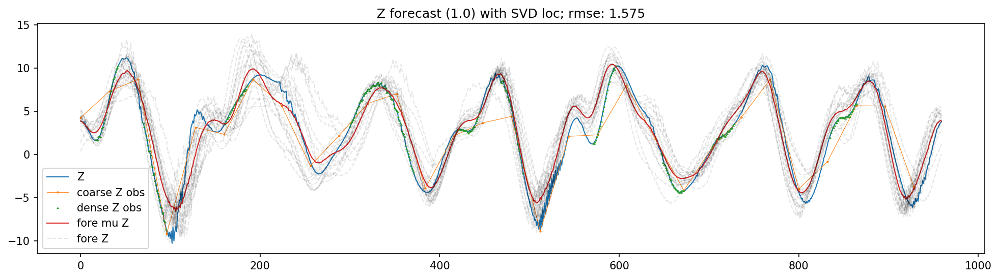

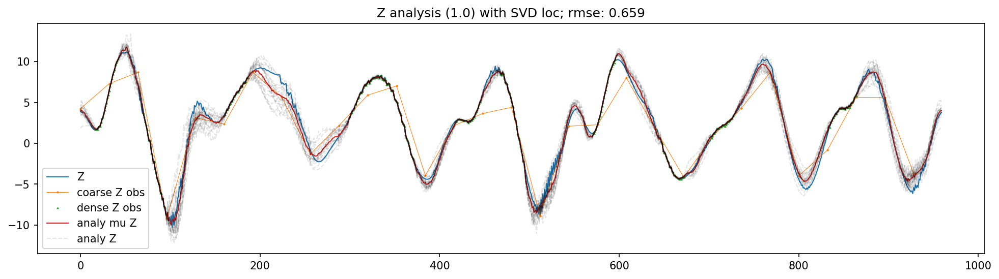

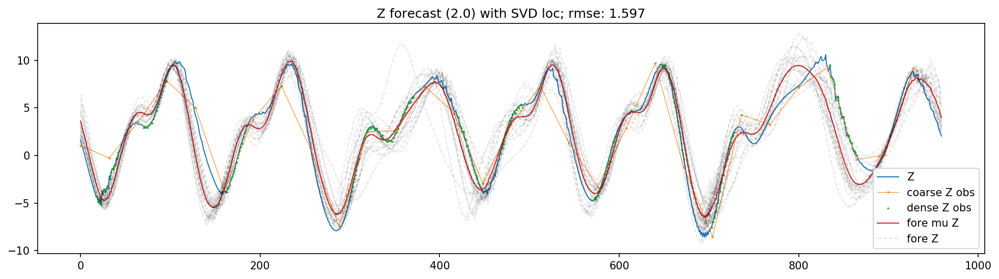

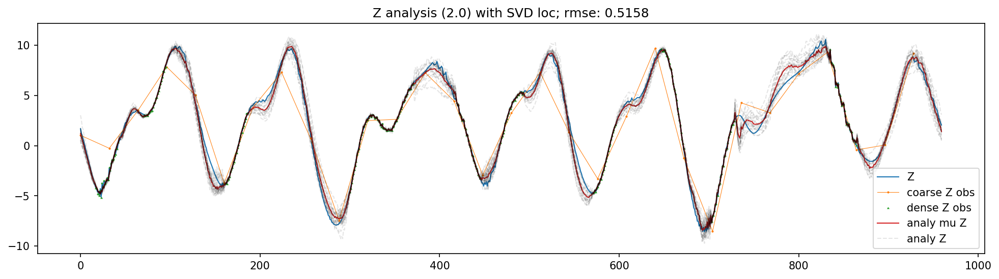

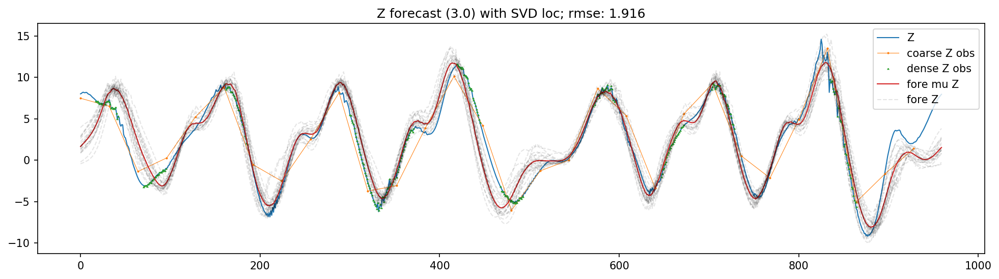

...

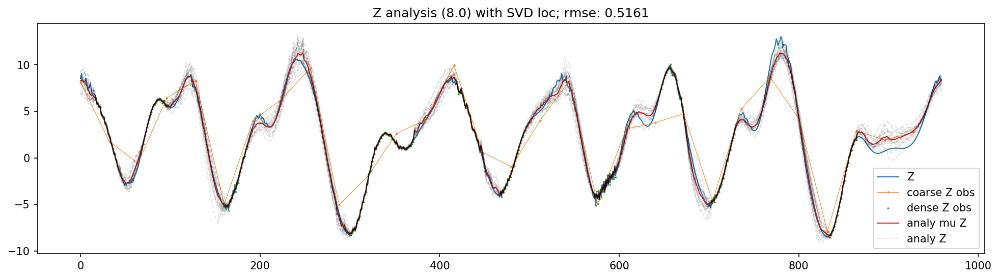

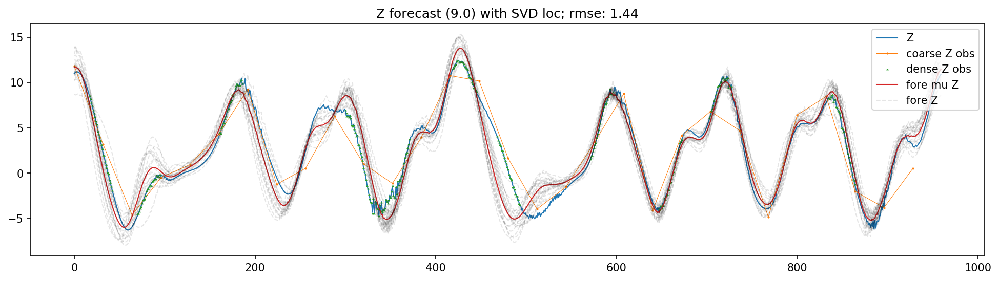

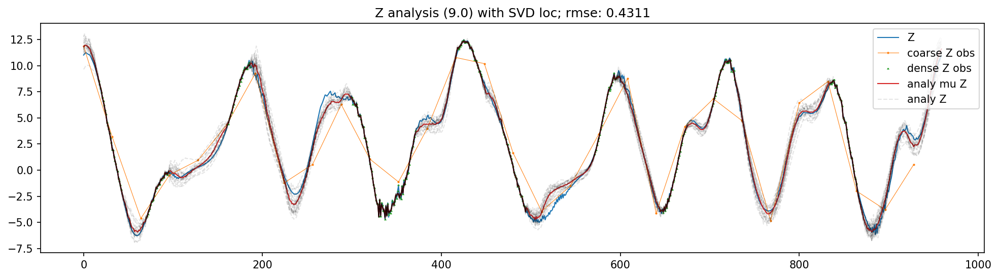

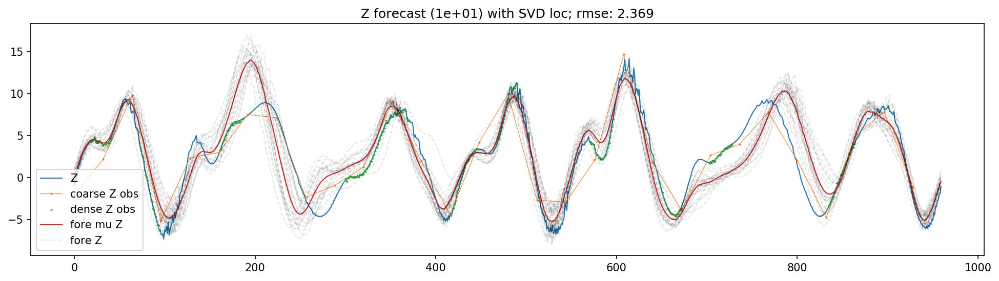

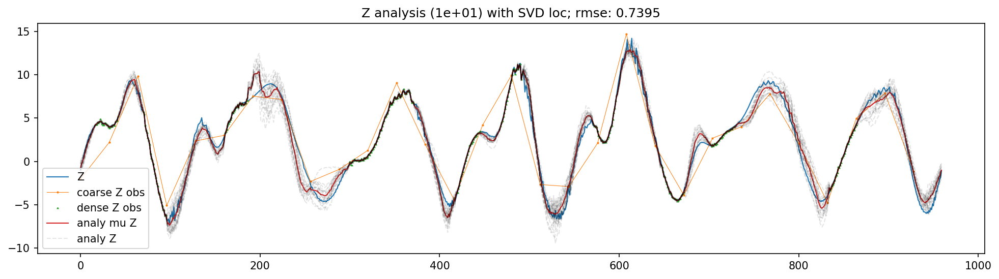

In [581]:
this_array = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10], dtype=float)
for count, this_time in enumerate(this_array):
    this_ens = Za_ens_ts[count].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

    
    this_ens = Za_ens_ts[count + 1].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Forecast RMSE')

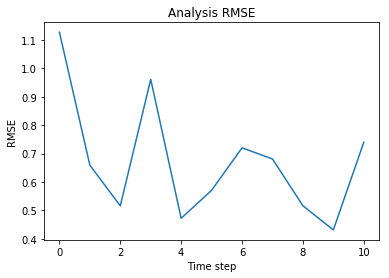

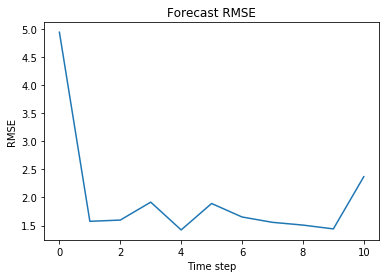

In [596]:
rmse = [1.127, 0.659, 0.5158, 0.9612, 0.4719, 0.5706, 0.7201, 0.6809, 0.5161, 0.4311, 0.7395]
plt.figure()
plt.plot(rmse)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Analysis RMSE')

rmse = [4.939, 1.575, 1.597, 1.916, 1.422, 1.892, 1.652, 1.557, 1.508, 1.44, 2.369]
plt.figure()
plt.plot(rmse)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Forecast RMSE')

# Cycle with standard localization

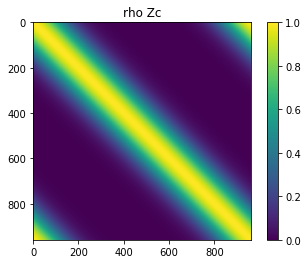

In [587]:
# rho0_Zf = 5
# rho_Zf = np.arange(N_Z)
# rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
# rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
# rho_Zf = sp.linalg.circulant(rho_Zf)
# imshow(rho_Zf, 'rho Zf',
#        vmin=0, vmax=1)
# imshow(rho_Zf[:20, :20], 'rho Zf zoom',
#        vmin=0, vmax=1)

rho0_Zc = 100
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
imshow(rho_Zc, 'rho Zc',
       vmin=0, vmax=1)

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'H_sub': H_sub,
              'R_sub': R_sub,
              'assim_type': 'standard loc'}

In [588]:
importlib.reload(assimilate)
importlib.reload(utilities)

Xa_ens_ts, Za_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
4.0
assimed
pushed Z
pushed X
5.0
assimed
pushed Z
pushed X
6.0
assimed
pushed Z
pushed X
7.0
assimed
pushed Z
pushed X
8.0
assimed
pushed Z
pushed X
9.0
assimed
pushed Z
pushed X
10.0
assimed
pushed Z
pushed X


In [589]:
atitle='standard loc'

Text(0.5,1,'Z analysis with standard loc; rmse: 1.287')

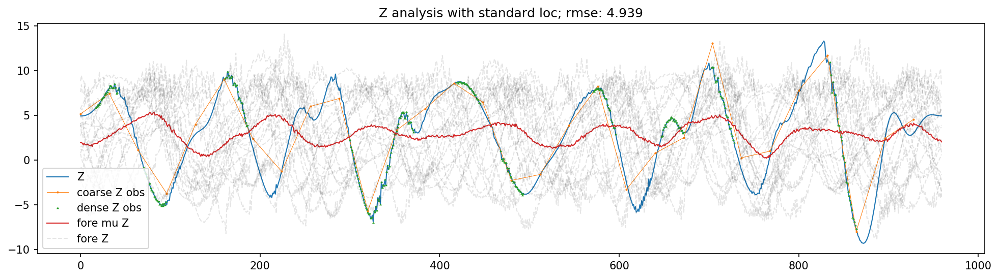

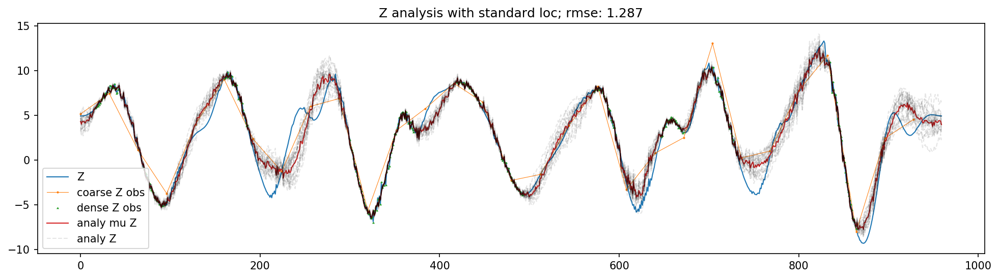

In [590]:
this_time = 0

this_ens = Z0_ens

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')


this_ens = Za_ens_ts[0].sel(time=this_time).values

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

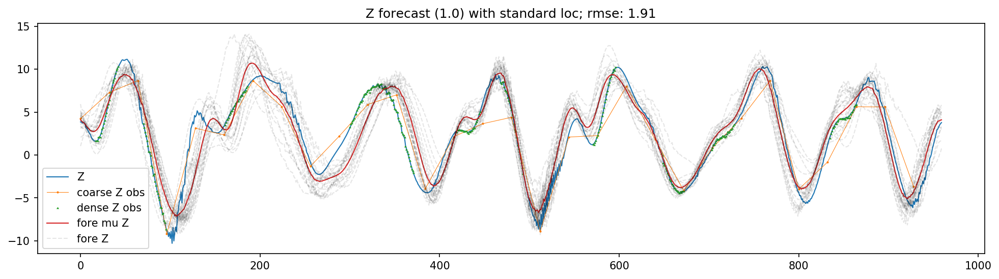

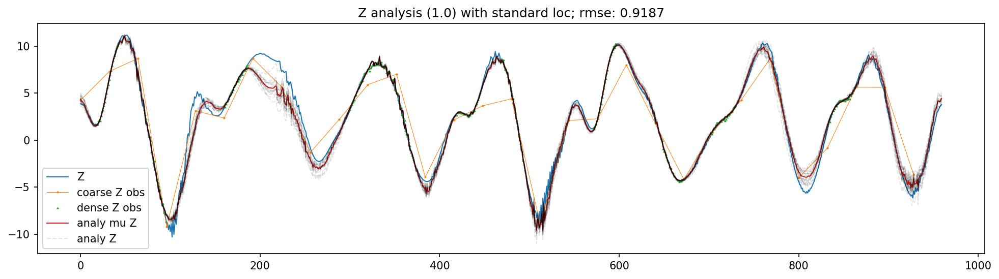

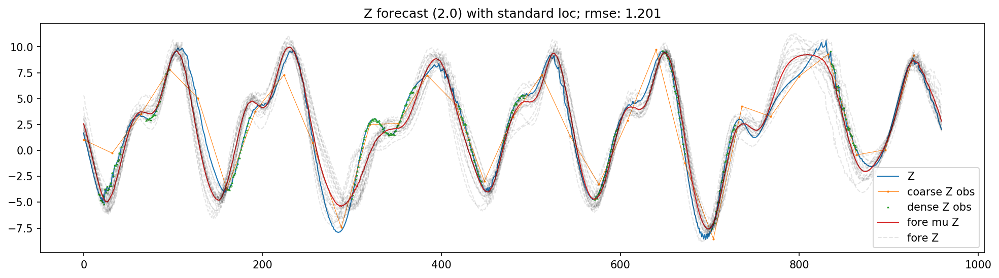

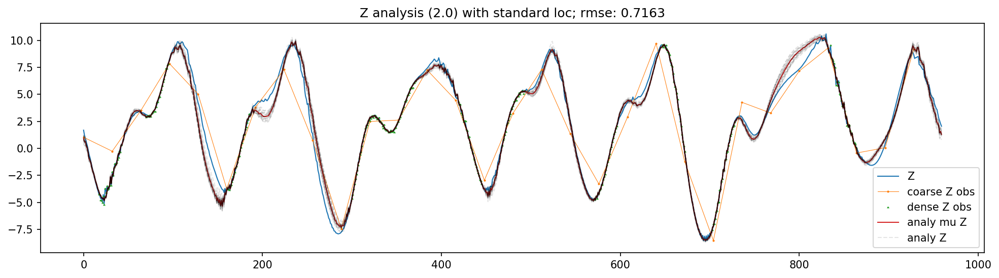

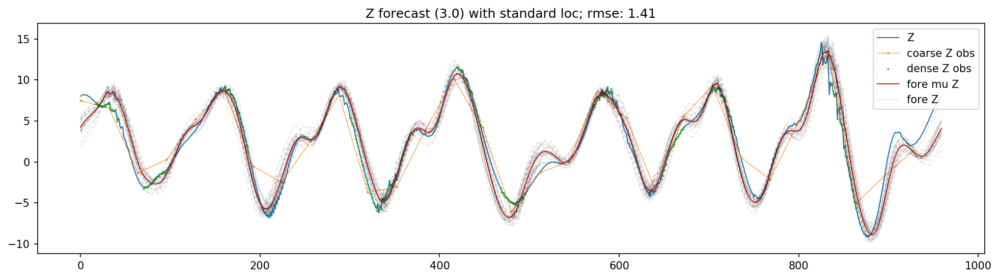

...

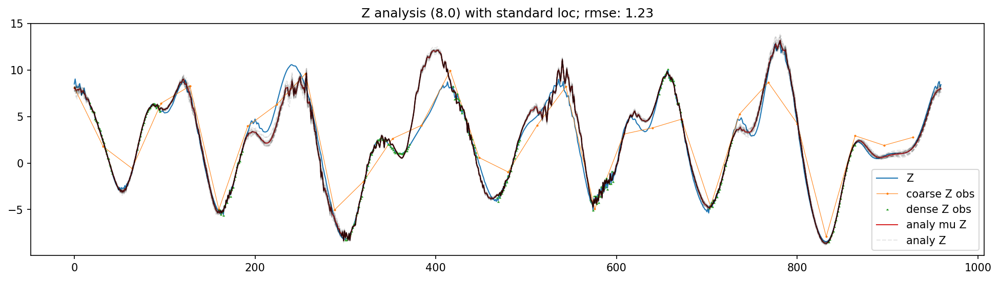

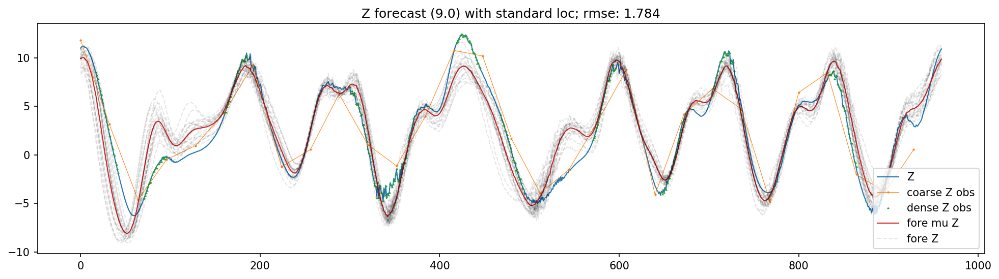

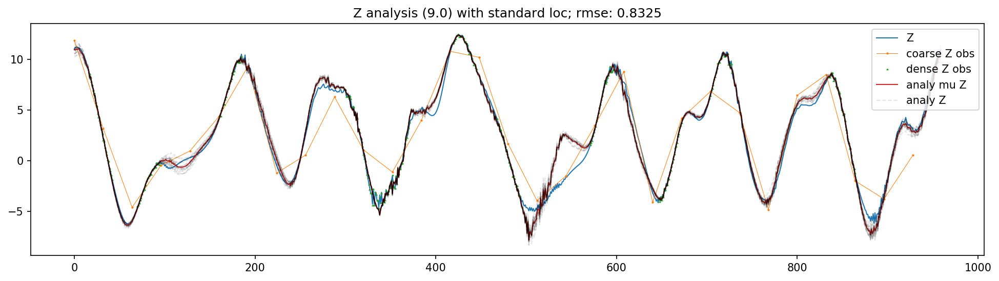

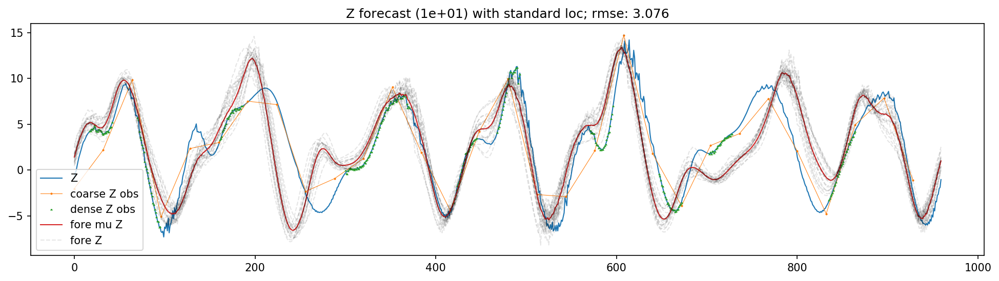

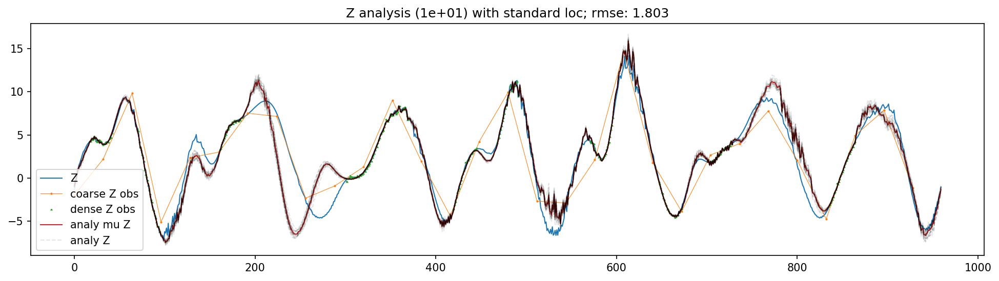

In [591]:
this_array = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10], dtype=float)
for count, this_time in enumerate(this_array):
    this_ens = Za_ens_ts[count].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

    
    this_ens = Za_ens_ts[count + 1].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

Text(0.5,1,'Forecast RMSE')

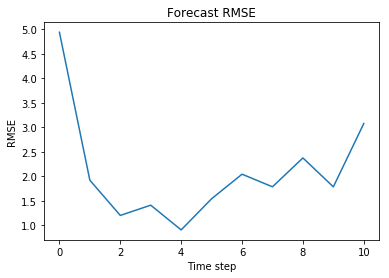

In [594]:
rmse = [4.939, 1.919, 1.201, 1.41, 0.9051, 1.541, 2.042, 1.785, 2.374, 1.784, 3.076]
plt.figure()
plt.plot(rmse)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Forecast RMSE')

Text(0.5,1,'Analysis RMSE')

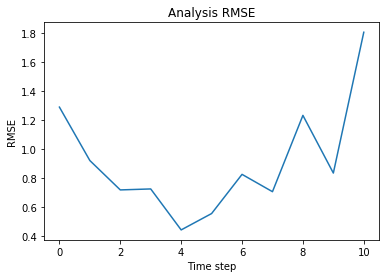

In [595]:
rmse = [1.287, 0.9187, 0.7163, 0.723, 0.4406, 0.5534, 0.8235, 0.7041, 1.23, 0.8325, 1.803]
plt.figure()
plt.plot(rmse)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Analysis RMSE')

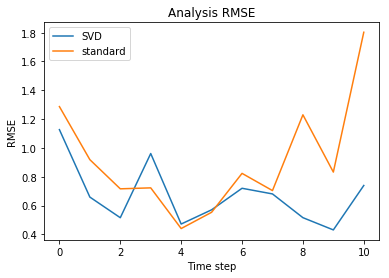

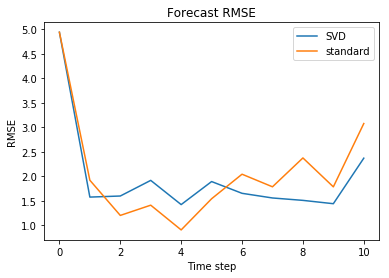

In [598]:
rmseSVD = [1.127, 0.659, 0.5158, 0.9612, 0.4719, 0.5706, 0.7201, 0.6809, 0.5161, 0.4311, 0.7395]
rmseStd = [1.287, 0.9187, 0.7163, 0.723, 0.4406, 0.5534, 0.8235, 0.7041, 1.23, 0.8325, 1.803]

plt.figure()
plt.plot(rmseSVD)
plt.plot(rmseStd)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Analysis RMSE')
plt.legend(['SVD', 'standard'])

rmseSVD = [4.939, 1.575, 1.597, 1.916, 1.422, 1.892, 1.652, 1.557, 1.508, 1.44, 2.369]
rmseStd = [4.939, 1.919, 1.201, 1.41, 0.9051, 1.541, 2.042, 1.785, 2.374, 1.784, 3.076]

plt.figure()
plt.plot(rmseSVD)
plt.plot(rmseStd)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Forecast RMSE')
plt.legend(['SVD', 'standard'])

# Cycle with SVD localization 

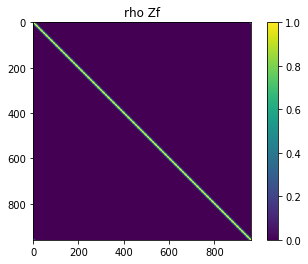

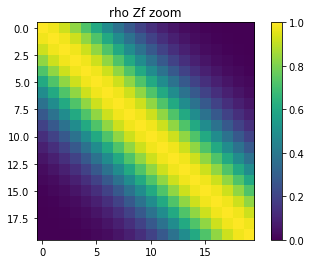

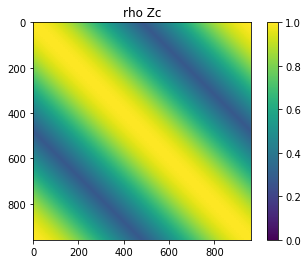

In [601]:
rho0_Zf = 5
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
imshow(rho_Zf, 'rho Zf',
       vmin=0, vmax=1)
imshow(rho_Zf[:20, :20], 'rho Zf zoom',
       vmin=0, vmax=1)

rho0_Zc = 300
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
imshow(rho_Zc, 'rho Zc',
       vmin=0, vmax=1)

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'rho_Zf': rho_Zf,
              'H_sub': H_sub, 'R_sub': R_sub,
              'assim_type': 'SVD_loc'}

In [602]:
importlib.reload(assimilate)
importlib.reload(utilities)

Xa_ens_ts, Za_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
4.0
assimed
pushed Z
pushed X
5.0
assimed
pushed Z
pushed X
6.0
assimed
pushed Z
pushed X
7.0
assimed
pushed Z
pushed X
8.0
assimed
pushed Z
pushed X
9.0
assimed
pushed Z
pushed X
10.0
assimed
pushed Z
pushed X


In [603]:
atitle='SVD loc'

Text(0.5,1,'Z analysis with SVD loc; rmse: 1.063')

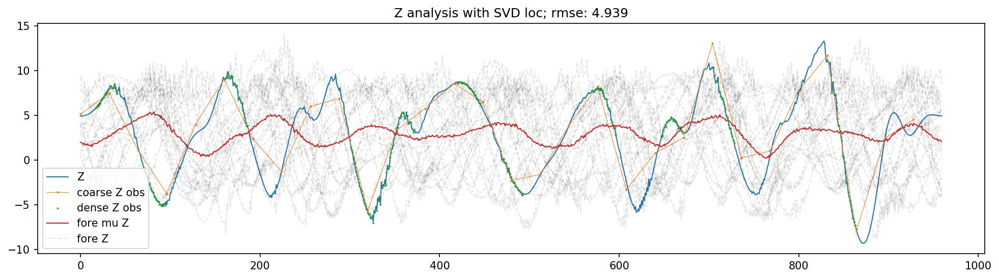

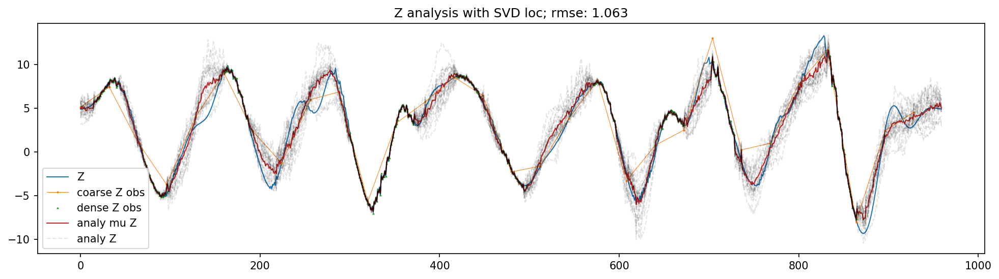

In [604]:
this_time = 0

this_ens = Z0_ens

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')


this_ens = Za_ens_ts[0].sel(time=this_time).values

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

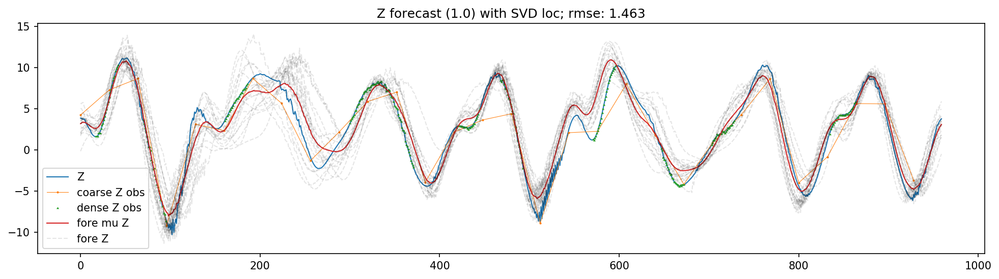

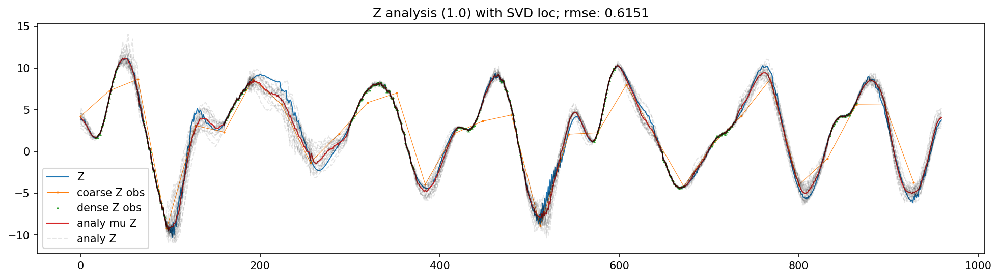

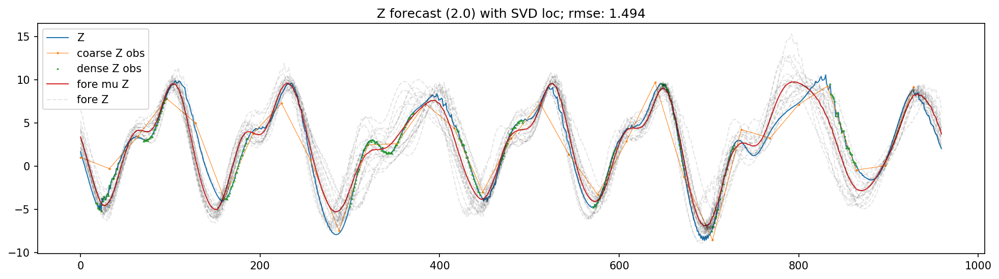

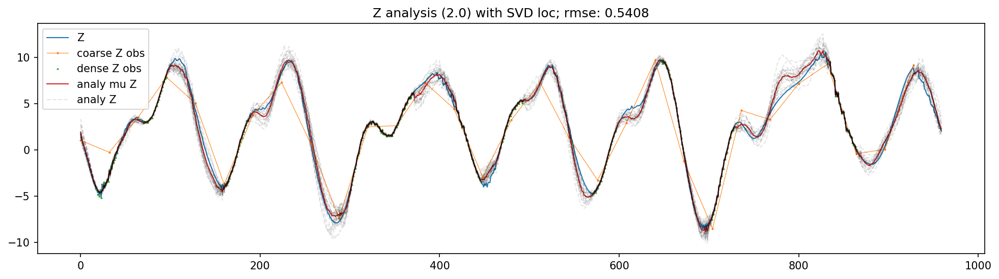

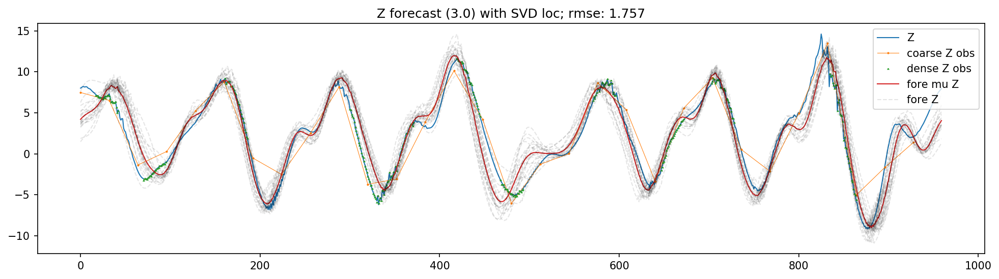

...

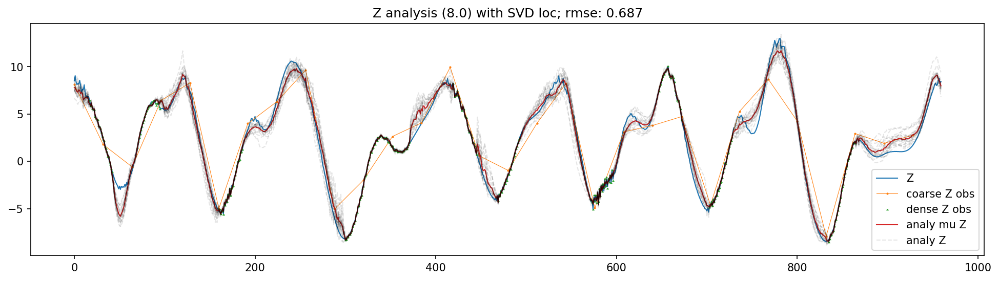

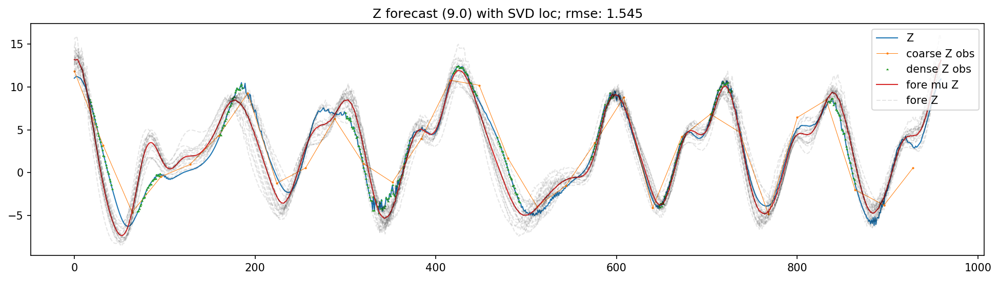

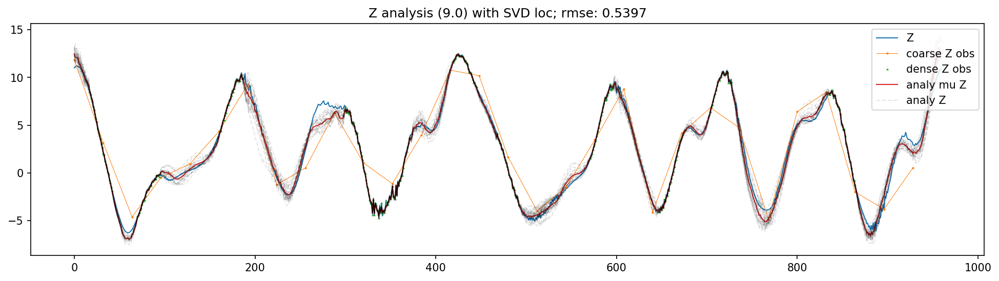

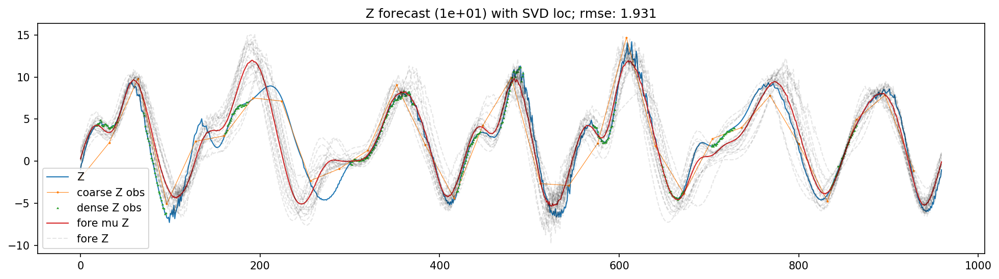

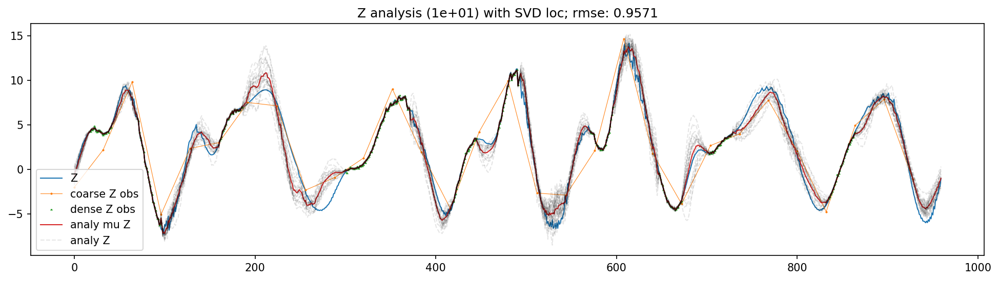

In [605]:
this_array = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10], dtype=float)
for count, this_time in enumerate(this_array):
    this_ens = Za_ens_ts[count].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

    
    this_ens = Za_ens_ts[count + 1].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

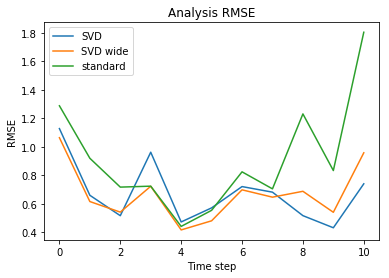

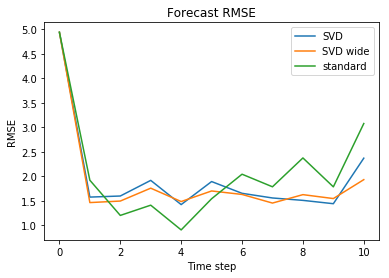

In [607]:
rmseSVD = [1.127, 0.659, 0.5158, 0.9612, 0.4719, 0.5706, 0.7201, 0.6809, 0.5161, 0.4311, 0.7395]
rmseSVD_w = [1.063, 0.6151, 0.5408, 0.7223, 0.416, 0.4799, 0.6973, 0.6458, 0.687, 0.5397, 0.9571]
rmseStd = [1.287, 0.9187, 0.7163, 0.723, 0.4406, 0.5534, 0.8235, 0.7041, 1.23, 0.8325, 1.803]

plt.figure()
plt.plot(rmseSVD)
plt.plot(rmseSVD_w)
plt.plot(rmseStd)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Analysis RMSE')
plt.legend(['SVD', 'SVD wide', 'standard'])

rmseSVD = [4.939, 1.575, 1.597, 1.916, 1.422, 1.892, 1.652, 1.557, 1.508, 1.44, 2.369]
rmseSVD_w = [4.939, 1.463, 1.494, 1.757, 1.484, 1.7, 1.629, 1.453, 1.625, 1.545, 1.931]
rmseStd = [4.939, 1.919, 1.201, 1.41, 0.9051, 1.541, 2.042, 1.785, 2.374, 1.784, 3.076]

plt.figure()
plt.plot(rmseSVD)
plt.plot(rmseSVD_w)
plt.plot(rmseStd)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Forecast RMSE')
plt.legend(['SVD', 'SVD wide', 'standard'])

# Cycle with SVD localization 

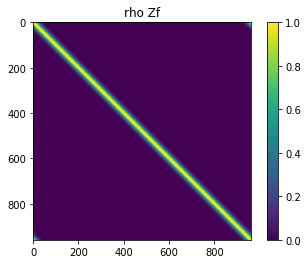

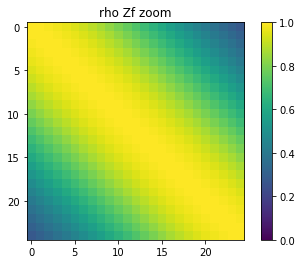

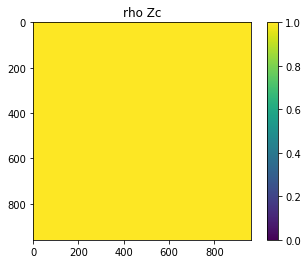

In [611]:
rho0_Zf = 15
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
imshow(rho_Zf, 'rho Zf',
       vmin=0, vmax=1)
imshow(rho_Zf[:25, :25], 'rho Zf zoom',
       vmin=0, vmax=1)

rho0_Zc = 300
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)

rho_Zc = np.ones_like(rho_Zc)
imshow(rho_Zc, 'rho Zc',
       vmin=0, vmax=1)

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'rho_Zf': rho_Zf,
              'H_sub': H_sub, 'R_sub': R_sub,
              'assim_type': 'SVD_loc'}

In [ ]:
importlib.reload(assimilate)
importlib.reload(utilities)

Xa_ens_ts, Za_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
4.0
assimed
pushed Z
pushed X
5.0
assimed
pushed Z


In [ ]:
atitle='SVD loc'

In [ ]:
this_time = 0

this_ens = Z0_ens

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')


this_ens = Za_ens_ts[0].sel(time=this_time).values

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.sel(time=this_time), linewidth=1)
plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

mu = np.mean(this_ens, axis=-1)
rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

In [ ]:
this_array = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10], dtype=float)
for count, this_time in enumerate(this_array):
    this_ens = Za_ens_ts[count].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'fore mu Z', 'fore Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

    
    this_ens = Za_ens_ts[count + 1].sel(time=this_time).values

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Zc_obs_loc, Z_obs_ts.sel(time=this_time)[:N_co], '-o', markersize=1, linewidth=0.5)
    plt.plot(Zd_obs_loc, Z_obs_ts.sel(time=this_time)[N_co:], '^', markersize=.75)
    plt.plot(np.mean(this_ens, axis=-1), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'coarse Z obs', 'dense Z obs', 'analy mu Z', 'analy Z'])

    mu = np.mean(this_ens, axis=-1)
    rmse = np.sqrt(((mu - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis ({this_time:0.2}) with {atitle}; rmse: {rmse:0.4}')

In [ ]:
rmseSVD = [1.127, 0.659, 0.5158, 0.9612, 0.4719, 0.5706, 0.7201, 0.6809, 0.5161, 0.4311, 0.7395]
rmseSVD_w = [1.063, 0.6151, 0.5408, 0.7223, 0.416, 0.4799, 0.6973, 0.6458, 0.687, 0.5397, 0.9571]
rmseStd = [1.287, 0.9187, 0.7163, 0.723, 0.4406, 0.5534, 0.8235, 0.7041, 1.23, 0.8325, 1.803]

plt.figure()
plt.plot(rmseSVD)
plt.plot(rmseSVD_w)
plt.plot(rmseStd)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Analysis RMSE')
plt.legend(['SVD', 'SVD wide', 'standard'])

rmseSVD = [4.939, 1.575, 1.597, 1.916, 1.422, 1.892, 1.652, 1.557, 1.508, 1.44, 2.369]
rmseSVD_w = [4.939, 1.463, 1.494, 1.757, 1.484, 1.7, 1.629, 1.453, 1.625, 1.545, 1.931]
rmseStd = [4.939, 1.919, 1.201, 1.41, 0.9051, 1.541, 2.042, 1.785, 2.374, 1.784, 3.076]

plt.figure()
plt.plot(rmseSVD)
plt.plot(rmseSVD_w)
plt.plot(rmseStd)
plt.xlabel('Time step')
plt.ylabel('RMSE')
plt.title('Forecast RMSE')
plt.legend(['SVD', 'SVD wide', 'standard'])